In [1]:
import sys, os
import json, pickle
import matplotlib.pyplot as plt
import matplotlib as mpl
import numpy as np
import pandas as pd
import time as pytime
import statsmodels.tsa.stattools as tsa
import ruptures as rpt
sys.path.append('..')
import InsanallyLabEphysTools as ilep
from scipy.stats import gaussian_kde, sem, ttest_ind, ttest_rel, norm, mannwhitneyu, linregress, wilcoxon
from tqdm import tqdm
from types import SimpleNamespace
from sklearn import linear_model
from itertools import product
from ipyparallel import Client
from datetime import datetime

from KDEpy import FFTKDE

from sklearn.model_selection import GridSearchCV, StratifiedKFold
from sklearn.neighbors import KernelDensity

plt.rcParams['legend.fontsize'] = 'small'
plt.rcParams['axes.labelsize'] = 'medium'
plt.rcParams['axes.formatter.limits'] = [-2,3]
plt.rcParams['axes.formatter.use_mathtext'] = True
plt.rcParams['axes.spines.top'] = False
plt.rcParams['axes.spines.right'] = False
plt.rcParams['xtick.direction'] = 'in'
plt.rcParams['ytick.direction'] = 'in'
plt.rcParams['figure.dpi'] = '150'

#Set global font parameters
plt.rcParams['font.family'] = 'sans-serif'
plt.rcParams['font.sans-serif'] = 'Arial'
#Set font type to TrueType for compatibility
plt.rcParams['pdf.fonttype'] = 42
plt.rcParams['ps.fonttype'] = 42

act_directory = 'D:\\Analysis_Cache'
act_directory_compare_to = 'D:\\Analysis_Cache - Copy before recalculating ChoiceModulation'
ops_directory = 'D:\\Opsin_Cache'

ephys_animals = ['BS_40','BS_41','BS_42','BS_49','BS_50','BS_51','BS_56','BS_59','BS_67','BS_70','BS_72','BS_87','BS_108','DS_15','DS_19']
passive_animals = ['TH_201','TH_203','LA_204','LA_205','TH_200', 'TH_230','AE_229','TH_233','TH_234']
did_not_learn_opsin_animals = ['BS_86','BS_100','BS_119','BS_123','BS_128','BS_131','BS_163','BS_174']

# Single-Threaded Operations

In [2]:
# sorting_directory = 'O:\\Sorts\\DualRecording'
# cache_directory = 'C:\\Users\\4thgr\\Downloads\\Analysis_Cache'
sorting_directory = 'O:\\Sorts\\OpsinControls'
cache_directory = 'C:\\Users\\4thgr\\Downloads\\Opsin_Controls_Cache'

In [3]:
starttime = pytime.time()
   
#Trim Sessions
starttimetrim = pytime.time()
ilep.trimSessions(sorting_directory,replace=False)
endtimetrim = pytime.time()

#Calculate Responsiveness
starttimeresponsiveness = pytime.time()
ilep.calculateResponsiveness(sorting_directory,cachedDirectory=cache_directory,replace=True)
endtimeresponsiveness = pytime.time()

#Calculate Tuning Responsiveness
starttimetuning = pytime.time()
#ilep.calculateTuningResponsiveness(sorting_directory,cachedDirectory=cache_directory,replace=False)
endtimetuning = pytime.time()

#Finish
starttimepackage = pytime.time()
ilep.loadSessionsComplete(sorting_directory,destination=cache_directory,verbose=False)
endtimepackage = pytime.time()

print('Trimming       : ' + str((endtimetrim-starttimetrim)/60)+' minutes elapsed');
print('Responsiveness : ' + str((endtimeresponsiveness-starttimeresponsiveness)/60)+' minutes elapsed');
print('Tuning         : ' + str((endtimetuning-starttimetuning)/60)+' minutes elapsed');
print('Finished       : ' + str((endtimepackage-starttimepackage)/60)+' minutes elapsed');

  0%|          | 0/6 [00:00<?, ?it/s]

[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_350\\AE_350 1\\AC\\condition_metadata.json'
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_350\\AE_350 1\\AC\\trim.pickle'
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_350\\AE_350 1\\AC\\responsiveness.pickle'
ERROR: Calculating laser stimulation
ERROR: Calculating laser stimulation
ERROR: Calculating laser stimulation
O:\Sorts\OpsinControls\AE_350\AE_350 1\AC\session_metadata.json complete
O:\Sorts\OpsinControls\AE_350\AE_350 1\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_350\AE_350 1\Striatum\session_metadata.json missing. Skipping
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_350\\AE_350 10\\AC\\condition_metadata.json'
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_350\\AE_350 10\\AC\\trim.pickle'
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_350\\AE_350 10\\AC\\responsiveness.pickle'
ERROR

 50%|█████     | 3/6 [01:21<01:21, 27.32s/it]

O:\Sorts\OpsinControls\AE_350\AE_350 9\AC\session_metadata.json complete
O:\Sorts\OpsinControls\AE_350\AE_350 9\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_350\AE_350 9\Striatum\session_metadata.json missing. Skipping
AE_350 complete
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_351\\AE_351 1\\AC\\condition_metadata.json'
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_351\\AE_351 1\\AC\\trim.pickle'
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_351\\AE_351 1\\AC\\responsiveness.pickle'
O:\Sorts\OpsinControls\AE_351\AE_351 1\AC\session_metadata.json complete
O:\Sorts\OpsinControls\AE_351\AE_351 1\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 1\Striatum\session_metadata.json missing. Skipping
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_351\\AE_351 2\\AC\\condition_metadata.json'
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_3

 67%|██████▋   | 4/6 [03:13<01:49, 54.62s/it]

O:\Sorts\OpsinControls\AE_351\AE_351 6\AC\session_metadata.json complete
O:\Sorts\OpsinControls\AE_351\AE_351 6\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 6\Striatum\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 7\AC\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 7\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 7\Striatum\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 8\AC\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 8\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 8\Striatum\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 9\AC\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 9\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 9\Striatum\session_metadata.json missing. Skipping
A

100%|██████████| 6/6 [04:28<00:00, 44.79s/it]


O:\Sorts\OpsinControls\AE_359\AE_359 6\AC\session_metadata.json complete
O:\Sorts\OpsinControls\AE_359\AE_359 6\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_359\AE_359 6\Striatum\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_359\AE_359 7\AC\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_359\AE_359 7\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_359\AE_359 7\Striatum\session_metadata.json missing. Skipping
AE_359 complete
O:\Sorts\OpsinControls complete


0it [00:00, ?it/s]
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:461: RuntimeWarning: Mean of empty slice
  populationAverageLickResponse = np.nanmean(populationResponses)
  0%|          | 0/6 [00:00<?, ?it/s]

[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_350\\AE_350 1\\AC\\condition_metadata.json'
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_350\\AE_350 1\\AC\\responsiveness.pickle'
ERROR: Calculating laser stimulation
ERROR: Calculating laser stimulation
ERROR: Calculating laser stimulation
session AE_350_1_AC_09-25-2024 clust 0 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_1_AC_09-25-2024 clust 0 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_1_AC_09-25-2024 clust 0 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_1_AC_09-25-2024 clust 0 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_1_

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\Ins

session AE_350_1_AC_09-25-2024 clust 18 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_1_AC_09-25-2024 clust 18 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_1_AC_09-25-2024 clust 18 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_1_AC_09-25-2024 clust 18 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_1_AC_09-25-2024 clust 18 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_1_AC_09-25-2024 clust 18 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_1

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_350_10_AC_10-8-2024 clust 2 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_10_AC_10-8-2024 clust 2 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_10_AC_10-8-2024 clust 2 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_10_AC_10-8-2024 clust 2 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_10_AC_10-8-2024 clust 2 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_10_AC_10-8-2024 clust 2 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_10_AC_1

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_350_10_AC_10-8-2024 clust 22 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_10_AC_10-8-2024 clust 22 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_10_AC_10-8-2024 clust 22 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_10_AC_10-8-2024 clust 22 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_10_AC_10-8-2024 clust 22 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_10_AC_10-8-2024 clust 22 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_1

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_350_2_AC_09-26-2024 clust 10 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_2_AC_09-26-2024 clust 10 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_2_AC_09-26-2024 clust 10 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_2_AC_09-26-2024 clust 10 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_2_AC_09-26-2024 clust 10 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_2_AC_09-26-2024 clust 10 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_2

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_350_2_AC_09-26-2024 clust 18 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_2_AC_09-26-2024 clust 18 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_2_AC_09-26-2024 clust 18 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_2_AC_09-26-2024 clust 18 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_2_AC_09-26-2024 clust 18 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_2_AC_09-26-2024 clust 18 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_2

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_350_3_AC_09-27-2024 clust 26 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_3_AC_09-27-2024 clust 26 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_3_AC_09-27-2024 clust 26 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_3_AC_09-27-2024 clust 26 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_3_AC_09-27-2024 clust 26 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_3_AC_09-27-2024 clust 26 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_3

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_350_3_AC_09-27-2024 clust 114 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_3_AC_09-27-2024 clust 114 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_3_AC_09-27-2024 clust 114 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_3_AC_09-27-2024 clust 114 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_3_AC_09-27-2024 clust 114 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_3_AC_09-27-2024 clust 114 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_350_5_AC_10-01-2024 clust 68 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_5_AC_10-01-2024 clust 68 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_5_AC_10-01-2024 clust 68 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_5_AC_10-01-2024 clust 68 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_5_AC_10-01-2024 clust 68 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_5_AC_10-01-2024 clust 68 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_5

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_350_5_AC_10-01-2024 clust 91 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_5_AC_10-01-2024 clust 91 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_5_AC_10-01-2024 clust 91 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_5_AC_10-01-2024 clust 91 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_5_AC_10-01-2024 clust 91 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_5_AC_10-01-2024 clust 91 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_5

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_350_5_AC_10-01-2024 clust 102 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_5_AC_10-01-2024 clust 102 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_5_AC_10-01-2024 clust 102 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_5_AC_10-01-2024 clust 102 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_5_AC_10-01-2024 clust 102 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_5_AC_10-01-2024 clust 102 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_350_9_AC_10-7-2024 clust 15 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_9_AC_10-7-2024 clust 15 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_9_AC_10-7-2024 clust 15 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_9_AC_10-7-2024 clust 15 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_9_AC_10-7-2024 clust 15 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_9_AC_10-7-2024 clust 15 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_9_AC_10

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_350_9_AC_10-7-2024 clust 27 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_9_AC_10-7-2024 clust 27 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_9_AC_10-7-2024 clust 27 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_9_AC_10-7-2024 clust 27 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_9_AC_10-7-2024 clust 27 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_9_AC_10-7-2024 clust 27 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_350_9_AC_10

 50%|█████     | 3/6 [07:03<07:03, 141.30s/it]

O:\Sorts\OpsinControls\AE_350\AE_350 9\AC\session_metadata.json complete
O:\Sorts\OpsinControls\AE_350\AE_350 9\M2\session_metadata.json missing. Skipping
AE_350 complete
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_351\\AE_351 1\\AC\\condition_metadata.json'
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_351\\AE_351 1\\AC\\responsiveness.pickle'
session AE_351_1_AC_9-27-2024 clust 2 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-27-2024 clust 2 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-27-2024 clust 2 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-27-2024 clust 2 tried to load saved active trials but failed. Error: [Errno 2] No such file or direct

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_351_1_AC_9-27-2024 clust 31 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-27-2024 clust 31 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-27-2024 clust 31 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-27-2024 clust 31 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-27-2024 clust 31 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-27-2024 clust 31 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_351_1_AC_9-27-2024 clust 39 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-27-2024 clust 39 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-27-2024 clust 39 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-27-2024 clust 39 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-27-2024 clust 39 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-27-2024 clust 39 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_351_1_AC_9-27-2024 clust 48 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-27-2024 clust 48 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-27-2024 clust 48 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-27-2024 clust 48 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-27-2024 clust 48 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-27-2024 clust 48 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_1_AC_9-

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_351_2_AC_9-30-2024 clust 53 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_2_AC_9-30-2024 clust 53 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_2_AC_9-30-2024 clust 53 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_2_AC_9-30-2024 clust 53 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_2_AC_9-30-2024 clust 53 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_2_AC_9-30-2024 clust 53 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_2_AC_9-

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_351_2_AC_9-30-2024 clust 124 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_2_AC_9-30-2024 clust 124 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_2_AC_9-30-2024 clust 124 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_2_AC_9-30-2024 clust 124 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_2_AC_9-30-2024 clust 124 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_2_AC_9-30-2024 clust 124 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_2

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_351_3_AC_10-1-2024 clust 14 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_3_AC_10-1-2024 clust 14 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_3_AC_10-1-2024 clust 14 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_3_AC_10-1-2024 clust 14 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_3_AC_10-1-2024 clust 14 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_3_AC_10-1-2024 clust 14 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_3_AC_10

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_351_3_AC_10-1-2024 clust 16 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_3_AC_10-1-2024 clust 16 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_3_AC_10-1-2024 clust 16 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_3_AC_10-1-2024 clust 16 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_3_AC_10-1-2024 clust 16 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_3_AC_10-1-2024 clust 16 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_3_AC_10

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_351_3_AC_10-1-2024 clust 17 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_3_AC_10-1-2024 clust 17 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_3_AC_10-1-2024 clust 17 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_3_AC_10-1-2024 clust 17 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_3_AC_10-1-2024 clust 17 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_3_AC_10-1-2024 clust 17 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_3_AC_10

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\Ins

session AE_351_4_AC_10-2-2024 clust 40 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_4_AC_10-2-2024 clust 40 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_4_AC_10-2-2024 clust 40 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_4_AC_10-2-2024 clust 40 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_4_AC_10-2-2024 clust 40 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_4_AC_10-2-2024 clust 40 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_4_AC_10

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_351_5_AC_10-3-2024 clust 27 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_5_AC_10-3-2024 clust 27 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_5_AC_10-3-2024 clust 27 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_5_AC_10-3-2024 clust 27 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_5_AC_10-3-2024 clust 27 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_5_AC_10-3-2024 clust 27 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_5_AC_10

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_351_5_AC_10-3-2024 clust 49 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_5_AC_10-3-2024 clust 49 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_5_AC_10-3-2024 clust 49 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_5_AC_10-3-2024 clust 49 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_5_AC_10-3-2024 clust 49 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_5_AC_10-3-2024 clust 49 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_5_AC_10

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_351_6_AC_10-4-2024 clust 119 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_6_AC_10-4-2024 clust 119 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_6_AC_10-4-2024 clust 119 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_6_AC_10-4-2024 clust 119 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_6_AC_10-4-2024 clust 119 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_6_AC_10-4-2024 clust 119 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_6

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_351_6_AC_10-4-2024 clust 155 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_6_AC_10-4-2024 clust 155 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_6_AC_10-4-2024 clust 155 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_6_AC_10-4-2024 clust 155 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_6_AC_10-4-2024 clust 155 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_6_AC_10-4-2024 clust 155 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_351_6

 67%|██████▋   | 4/6 [14:38<08:04, 242.44s/it]

O:\Sorts\OpsinControls\AE_351\AE_351 6\AC\session_metadata.json complete
O:\Sorts\OpsinControls\AE_351\AE_351 6\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 7\AC\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 7\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 8\AC\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 8\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 9\AC\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 9\M2\session_metadata.json missing. Skipping
AE_351 complete
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_359\\AE_359 1\\AC\\condition_metadata.json'
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_359\\AE_359 1\\AC\\responsiveness.pickle'
ERROR: Calculating laser stimulation
ERROR: Calculating laser stimulation
ERROR: Calculating laser stimulation
sessio

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_359_1_AC_11-6-2024 clust 31 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_1_AC_11-6-2024 clust 31 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_1_AC_11-6-2024 clust 31 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_1_AC_11-6-2024 clust 31 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_1_AC_11-6-2024 clust 31 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_1_AC_11-6-2024 clust 31 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_1_AC_11

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_359_1_AC_11-6-2024 clust 81 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_1_AC_11-6-2024 clust 81 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_1_AC_11-6-2024 clust 81 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_1_AC_11-6-2024 clust 81 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_1_AC_11-6-2024 clust 81 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_1_AC_11-6-2024 clust 81 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_1_AC_11

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_359_1_AC_11-6-2024 clust 110 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_1_AC_11-6-2024 clust 110 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_1_AC_11-6-2024 clust 110 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_1_AC_11-6-2024 clust 110 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_1_AC_11-6-2024 clust 110 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_1_AC_11-6-2024 clust 110 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_1

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_359_2_AC_11-7-2024 clust 28 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_2_AC_11-7-2024 clust 28 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_2_AC_11-7-2024 clust 28 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_2_AC_11-7-2024 clust 28 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_2_AC_11-7-2024 clust 28 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_2_AC_11-7-2024 clust 28 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_2_AC_11

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_359_2_AC_11-7-2024 clust 75 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_2_AC_11-7-2024 clust 75 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_2_AC_11-7-2024 clust 75 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_2_AC_11-7-2024 clust 75 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_2_AC_11-7-2024 clust 75 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_2_AC_11-7-2024 clust 75 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_2_AC_11

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_359_3_AC_11-8-2024 clust 21 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_3_AC_11-8-2024 clust 21 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_3_AC_11-8-2024 clust 21 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_3_AC_11-8-2024 clust 21 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_3_AC_11-8-2024 clust 21 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_3_AC_11-8-2024 clust 21 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_3_AC_11

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_359_3_AC_11-8-2024 clust 46 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_3_AC_11-8-2024 clust 46 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_3_AC_11-8-2024 clust 46 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_3_AC_11-8-2024 clust 46 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_3_AC_11-8-2024 clust 46 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_3_AC_11-8-2024 clust 46 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_3_AC_11

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_359_4_AC_11-11-2024 clust 28 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_4_AC_11-11-2024 clust 28 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_4_AC_11-11-2024 clust 28 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_4_AC_11-11-2024 clust 28 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_4_AC_11-11-2024 clust 28 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_4_AC_11-11-2024 clust 28 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_4

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_359_4_AC_11-11-2024 clust 94 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_4_AC_11-11-2024 clust 94 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_4_AC_11-11-2024 clust 94 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_4_AC_11-11-2024 clust 94 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_4_AC_11-11-2024 clust 94 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_4_AC_11-11-2024 clust 94 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_4

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_359_5_AC_11-12-2024 clust 7 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_5_AC_11-12-2024 clust 7 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_5_AC_11-12-2024 clust 7 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_5_AC_11-12-2024 clust 7 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_5_AC_11-12-2024 clust 7 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_5_AC_11-12-2024 clust 7 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_5_AC_11

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_359_5_AC_11-12-2024 clust 19 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_5_AC_11-12-2024 clust 19 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_5_AC_11-12-2024 clust 19 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_5_AC_11-12-2024 clust 19 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_5_AC_11-12-2024 clust 19 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_5_AC_11-12-2024 clust 19 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_5

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)
C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:229: RuntimeWarning: invalid value encountered in scalar divide
  responsiveness[cond].z_score = (FR[maxmodidx] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_359_6_AC_11-13-2024 clust 20 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_6_AC_11-13-2024 clust 20 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_6_AC_11-13-2024 clust 20 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_6_AC_11-13-2024 clust 20 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_6_AC_11-13-2024 clust 20 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_6_AC_11-13-2024 clust 20 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_6

C:\Users\4thgr\OneDrive\Documents\TothSidleck2024\Notebooks\..\InsanallyLabEphysTools\responsiveness.py:240: RuntimeWarning: divide by zero encountered in scalar divide
  responsiveness[cond].z_score_choice = (FR_choice - np.mean(baselineFR)) / np.std(baselineFR)#(FR_choice[maxmodidx_choice] - np.mean(baselineFR)) / np.std(baselineFR)


session AE_359_6_AC_11-13-2024 clust 42 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_6_AC_11-13-2024 clust 42 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_6_AC_11-13-2024 clust 42 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_6_AC_11-13-2024 clust 42 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_6_AC_11-13-2024 clust 42 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_6_AC_11-13-2024 clust 42 tried to load saved active trials but failed. Error: [Errno 2] No such file or directory: '..\\..\\Data\\trialsToUsePerDay'
session AE_359_6

100%|██████████| 6/6 [21:39<00:00, 216.62s/it]


O:\Sorts\OpsinControls\AE_359\AE_359 6\AC\session_metadata.json complete
O:\Sorts\OpsinControls\AE_359\AE_359 6\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_359\AE_359 7\AC\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_359\AE_359 7\M2\session_metadata.json missing. Skipping
AE_359 complete
O:\Sorts\OpsinControls complete


  0%|          | 0/6 [00:00<?, ?it/s]

[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_350\\AE_350 1\\AC\\condition_metadata.json'
ERROR: Calculating laser stimulation
ERROR: Calculating laser stimulation
ERROR: Calculating laser stimulation
A
C:\Users\4thgr\Downloads\Opsin_Controls_Cache\AE_350_1_opto_control_AC.pickle
B
O:\Sorts\OpsinControls\AE_350\AE_350 1\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_350\AE_350 1\MGB\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_350\AE_350 1\Striatum\session_metadata.json missing. Skipping
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_350\\AE_350 10\\AC\\condition_metadata.json'
ERROR: Calculating laser stimulation
A
C:\Users\4thgr\Downloads\Opsin_Controls_Cache\AE_350_10_opto_control_AC.pickle
B
O:\Sorts\OpsinControls\AE_350\AE_350 10\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_350\AE_350 10\MGB\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_350\AE_350 10\Stri

 50%|█████     | 3/6 [00:46<00:46, 15.47s/it]

A
C:\Users\4thgr\Downloads\Opsin_Controls_Cache\AE_350_9_opto_control_AC.pickle
B
O:\Sorts\OpsinControls\AE_350\AE_350 9\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_350\AE_350 9\MGB\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_350\AE_350 9\Striatum\session_metadata.json missing. Skipping
AE_350 complete
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_351\\AE_351 1\\AC\\condition_metadata.json'
A
C:\Users\4thgr\Downloads\Opsin_Controls_Cache\AE_351_1_opto_control_AC.pickle
B
O:\Sorts\OpsinControls\AE_351\AE_351 1\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 1\MGB\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 1\Striatum\session_metadata.json missing. Skipping
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_351\\AE_351 2\\AC\\condition_metadata.json'
A
C:\Users\4thgr\Downloads\Opsin_Controls_Cache\AE_351_2_opto_control_AC.pickle
B
O:\Sorts\O

 67%|██████▋   | 4/6 [01:36<00:53, 26.71s/it]

O:\Sorts\OpsinControls\AE_351\AE_351 9\AC\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 9\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 9\MGB\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_351\AE_351 9\Striatum\session_metadata.json missing. Skipping
AE_351 complete
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_359\\AE_359 1\\AC\\condition_metadata.json'
ERROR: Calculating laser stimulation
ERROR: Calculating laser stimulation
ERROR: Calculating laser stimulation
A
C:\Users\4thgr\Downloads\Opsin_Controls_Cache\AE_359_1_opto_control_AC.pickle
B
O:\Sorts\OpsinControls\AE_359\AE_359 1\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_359\AE_359 1\MGB\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_359\AE_359 1\Striatum\session_metadata.json missing. Skipping
[Errno 2] No such file or directory: 'O:\\Sorts\\OpsinControls\\AE_359\\AE_359 2\\AC\\condit

100%|██████████| 6/6 [02:23<00:00, 23.84s/it]

A
C:\Users\4thgr\Downloads\Opsin_Controls_Cache\AE_359_6_opto_control_AC.pickle
B
O:\Sorts\OpsinControls\AE_359\AE_359 6\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_359\AE_359 6\MGB\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_359\AE_359 6\Striatum\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_359\AE_359 7\AC\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_359\AE_359 7\M2\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_359\AE_359 7\MGB\session_metadata.json missing. Skipping
O:\Sorts\OpsinControls\AE_359\AE_359 7\Striatum\session_metadata.json missing. Skipping
AE_359 complete
O:\Sorts\OpsinControls complete
Trimming       : 4.47964878877004 minutes elapsed
Responsiveness : 21.662671558062236 minutes elapsed
Tuning         : 0.0 minutes elapsed
Finished       : 2.384469695885976 minutes elapsed


# Multi-threaded Operations

In [5]:
#rc = Client('/Users/balbanna/.starcluster/ipcluster/SecurityGroup:@sc-MI-us-east-1.json', sshkey='/Users/badr/.ssh/EC2key.rsa')
rc = Client()
dv = rc[:]
dv.block = True
dv.activate()
print("Number of active engines: {0}".format(len(dv)))

Number of active engines: 16


In [6]:
%%px --block
import InsanallyLabEphysTools as ilep

#%load_ext autoreload
#%autoreload 2

%px: 100%|██████████| 16/16 [00:00<00:00, 19.18tasks/s]


In [7]:
sorting_directory = 'S:\\Sorts\DualRecording'
cache_directory = 'D:\\Analysis_Cache'

# sorting_directory = 'S:\\Sorts\Opsin'
# cache_directory = 'D:\\Opsin_Cache'

In [12]:
list_of_sessions = ilep.getListOfSessionsToCalculateResponsiveness(sorting_directory,animals_list = ephys_animals,replace=True,regions=['AC'])#,animals_list = ['AE_267'])
list_of_s_directory = [sorting_directory]*len(list_of_sessions)
list_of_c_directory = [cache_directory]*len(list_of_sessions)

 41%|████▏     | 24/58 [00:00<00:00, 230.72it/s]

S:\Sorts\DualRecording\BS_108\BS_108 5\AC\session_metadata.json missing. Skipping
S:\Sorts\DualRecording\BS_108\BS_108 7\AC\session_metadata.json missing. Skipping
S:\Sorts\DualRecording\BS_108\BS_108 8\AC\session_metadata.json missing. Skipping
S:\Sorts\DualRecording\BS_108\BS_108 9\AC\session_metadata.json missing. Skipping
S:\Sorts\DualRecording\BS_40\BS_40 21\AC\session_metadata.json missing. Skipping
S:\Sorts\DualRecording\BS_40\BS_40 26\AC\session_metadata.json missing. Skipping
S:\Sorts\DualRecording\BS_41\BS_41 13\AC\session_metadata.json missing. Skipping
S:\Sorts\DualRecording\BS_49\BS_49 12\AC\session_metadata.json missing. Skipping
S:\Sorts\DualRecording\BS_49\BS_49 3\AC\session_metadata.json missing. Skipping
S:\Sorts\DualRecording\BS_49\BS_49 9\AC\session_metadata.json missing. Skipping
S:\Sorts\DualRecording\BS_50\BS_50 10\AC\session_metadata.json missing. Skipping
S:\Sorts\DualRecording\BS_50\BS_50 11\AC\session_metadata.json missing. Skipping
S:\Sorts\DualRecording\BS_

100%|██████████| 58/58 [00:00<00:00, 223.89it/s]

S:\Sorts\DualRecording\DS_15\DS_15 10\AC\session_metadata.json missing. Skipping
S:\Sorts\DualRecording\DS_15\DS_15 18\AC\session_metadata.json missing. Skipping
S:\Sorts\DualRecording\DS_19\DS_19 21\AC\session_metadata.json missing. Skipping
S:\Sorts\DualRecording\DS_19\DS_19 32\AC\session_metadata.json missing. Skipping
S:\Sorts\DualRecording\DS_19\DS_19 33\AC\session_metadata.json missing. Skipping


In [13]:
list_of_sessions

[('BS_108', 'BS_108 1', 'AC'),
 ('BS_108', 'BS_108 2', 'AC'),
 ('BS_108', 'BS_108 3', 'AC'),
 ('BS_108', 'BS_108 4', 'AC'),
 ('BS_108', 'BS_108 6', 'AC'),
 ('BS_40', 'BS_40 10', 'AC'),
 ('BS_40', 'BS_40 11', 'AC'),
 ('BS_40', 'BS_40 12', 'AC'),
 ('BS_40', 'BS_40 13', 'AC'),
 ('BS_40', 'BS_40 14', 'AC'),
 ('BS_40', 'BS_40 19', 'AC'),
 ('BS_40', 'BS_40 2', 'AC'),
 ('BS_40', 'BS_40 20', 'AC'),
 ('BS_40', 'BS_40 22', 'AC'),
 ('BS_40', 'BS_40 25', 'AC'),
 ('BS_40', 'BS_40 27', 'AC'),
 ('BS_40', 'BS_40 28', 'AC'),
 ('BS_40', 'BS_40 3', 'AC'),
 ('BS_40', 'BS_40 4', 'AC'),
 ('BS_40', 'BS_40 5', 'AC'),
 ('BS_40', 'BS_40 6', 'AC'),
 ('BS_40', 'BS_40 7', 'AC'),
 ('BS_40', 'BS_40 8', 'AC'),
 ('BS_41', 'BS_41 1', 'AC'),
 ('BS_41', 'BS_41 10', 'AC'),
 ('BS_41', 'BS_41 11', 'AC'),
 ('BS_41', 'BS_41 12', 'AC'),
 ('BS_41', 'BS_41 2', 'AC'),
 ('BS_41', 'BS_41 3', 'AC'),
 ('BS_41', 'BS_41 4', 'AC'),
 ('BS_41', 'BS_41 5', 'AC'),
 ('BS_41', 'BS_41 6', 'AC'),
 ('BS_41', 'BS_41 7', 'AC'),
 ('BS_41', 'BS_41 9

In [14]:
start_time = datetime.now()
print('Starting run at: '+str(start_time))
res = dv.map_sync(ilep.calculateResponsivenessBySession,list_of_sessions,list_of_s_directory,list_of_c_directory)

end_time = datetime.now()
print('Elapsed time: '+str(end_time-start_time))

Starting run at: 2024-04-03 14:07:45.642571
Elapsed time: 0:12:15.414044


In [ ]:
list_of_sessions = [('DS_15', 'DS_15 15', 'AC')]
list_of_s_directory = [sorting_directory]
list_of_c_directory = [cache_directory]

In [12]:
for idx,(session,s_dir,c_dir) in enumerate(zip(list_of_sessions,list_of_s_directory,list_of_c_directory)):
    print(f"Starting session {idx}: {session} in {s_dir}, caching to {c_dir}")
    ilep.calculateResponsivenessBySession(session,s_dir,c_dir)

  1%|          | 8/723 [00:00<00:09, 74.06it/s]

Starting session 0: ('BS_108', 'BS_108 1', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_108', 'BS_108 1', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:08<00:00, 85.36it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 1 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 3 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[339, 356, 435], window_lengths=array([44895.,  8645.,  7176.])), 'target': namespace(label='ta

  0%|          | 0/723 [00:00<?, ?it/s]

Not enough trials! There are 3 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 1 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 3 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[339, 356, 435], window_lengths=array([44895.,  8645.,  7176.])), 'target': namespace(label='target', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingS

100%|██████████| 723/723 [00:08<00:00, 86.19it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 1 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 1 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 1 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 1 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[233, 235, 236], window_lengths=array([10791., 34430.,  9787.])), 'target': namespace(label='ta

  1%|          | 8/723 [00:00<00:08, 79.99it/s]

Not enough trials! There are 12 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=1.3888110128325213, rampingMod=-0.8728025914392447, rampingModNorm=-0.6284531036797713, rampingSlopePerBin=-0.07273354928660372, rampingSlopePerSec=-2.9093419714641486, trials=[233, 235, 236, 239, 240, 241, 243, 245, 246, 247, 248, 249, 250, 251, 252, 254, 255, 256, 257, 258, 259, 260, 261, 262, 265, 268, 269, 270, 273, 274, 275, 276, 277, 278, 279, 280, 283, 284, 285, 289, 290, 291, 292, 293, 294, 295, 297, 298, 299, 300, 301, 304, 305, 306, 309, 310, 311, 312, 313, 314, 316, 317, 319, 321, 322, 323, 324, 325, 326, 329, 330, 333, 335, 336, 339, 344, 345, 346, 348], window_lengths=array([10791.        , 34430.        ,  9787.        , 63080.        ,
        7574.        ,  9531.        , 10061.        , 10393.31353135,
        9990.        , 10393.31353135, 10393.31353135, 10393.31353135,
       19137.        , 10393.31353135,  8777.        , 59383.        ,
        9293. 

100%|██████████| 723/723 [00:08<00:00, 85.05it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a requ

..\InsanallyLabEphysTools\responsiveness.py:386: RuntimeWarning: Mean of empty slice
  avg_across_bins = np.nanmean(spiking_bins[trial_idx_sampled_list,:],axis=0)    #Is this the order that I want to do this in? I think so? Also I think this is actually across trials


Not enough trials! There are 8 out of a required 60
Not enough trials! There are 33 out of a required 60
Not enough trials! There are 28 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 33 out of a required 60
Not enough trials! There are 35 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 33 out of a required 60
Not enough trials! There are 35 out of a required 60
Not enough trials! There are 23 out of a required 60
Not enough trials! There are 45 out of a required 60
Not enough trials! There are 35 out of a required 60
Not enough trials! There are 33 out of a required 60
Not enough trials! There are 8 out of a required 60
Not enough trials! There are 8 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 5 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBa

  1%|          | 7/723 [00:00<00:11, 63.62it/s]

S:\Sorts\DualRecording\BS_108\BS_108 3\AC\session_metadata.json complete
Starting session 3: ('BS_108', 'BS_108 4', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_108', 'BS_108 4', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:11<00:00, 64.03it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 51 out of a required 60
Not enough trials! There are 50 out of a required 60
Not enough trials! There are 31 out of a required 60
Not enough trials! There are 50 out of a required 60
Not enough trials! There are 19 out of a required 60
Not enough trials! There are 32 out of a required 60
Not enough trials! There are 27 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=3.922851264268831, rampingMod=-1.0761007624512908, rampingModNorm=-0.27431597324449214, rampingSlopePerBin=-0.08967506353760757, rampingSlopePerSec=-3.5870025415043028, trials=[150, 151, 153, 155, 156, 157, 158, 159, 160, 163, 164, 165, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 185, 186, 191, 193, 195, 196, 198, 199, 200, 202, 210, 215, 216, 217, 219, 220, 221, 222, 223, 224, 228, 229, 233, 238, 239, 241, 242, 243, 244, 250, 256, 260, 263, 265, 267,

  1%|          | 8/723 [00:00<00:08, 79.98it/s]

{'all_trials': namespace(label='all_trials', rampingBaseline=1.362494114676617, rampingMod=0.17072740687158836, rampingModNorm=0.12530506006046851, rampingSlopePerBin=0.014227283905965697, rampingSlopePerSec=0.5690913562386278, trials=[61, 75, 77, 81, 83, 84, 86, 88, 93, 98, 99, 102, 111, 122, 123, 132, 133, 134, 137, 141, 142, 143, 144, 145, 148, 149, 150, 151, 153, 155, 156, 157, 158, 159, 160, 163, 164, 165, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 185, 186, 191, 193, 195, 196, 198, 199, 200, 202, 210, 215, 216, 217, 219, 220, 221, 222, 223, 224, 228, 229, 233, 238, 239, 241, 242, 243, 244, 250, 256, 260, 263, 265, 267, 269, 270, 275, 277, 280, 284, 286, 289, 295, 301, 302, 303, 304, 305, 309, 310, 311, 313, 314, 317, 319, 320, 322, 323, 324, 326, 327, 329, 331, 332, 333, 334, 335, 336, 337, 338, 339, 340, 341, 342, 343, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 357, 358, 359, 360, 361, 362, 363, 364, 365, 366, 367, 368, 

100%|██████████| 723/723 [00:08<00:00, 87.94it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 21 out of a required 60
Not enough trials! There are 14 out of a required 60
Not enough trials! There are 7 out of a required 60
Not enough trials! There are 21 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 14 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 7 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 12 out of a required 60
Not enough trials! There are 9 out of a required 60
Not enough trials! There are 14 out of a required 60
Not enough trials! There are 7 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[29, 67, 114, 119, 191, 205, 233, 234, 238, 239, 241, 242, 247, 249, 252, 255, 263, 297, 

  0%|          | 0/723 [00:00<?, ?it/s]

Not enough trials! There are 8 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[29, 67, 114, 119, 191, 205, 233, 234, 238, 239, 241, 242, 247, 249, 252, 255, 263, 297, 334, 344, 345, 356, 369, 378, 427], window_lengths=array([13885.,  6242., 52080.,  9924., 10779., 10444., 51898., 47693.,
       66937., 22012., 58350., 46527.,  7875., 37819.,  9222.,  6774.,
        6667., 15632., 63184., 47754., 54222., 26247.,  8683., 67069.,
       62914.])), 'target': namespace(label='target', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[67, 114, 119, 191, 205, 238, 247, 249, 252, 255, 263, 334, 344, 345, 356, 378, 427], window_lengths=array([ 6242., 52080.,  9924., 10779., 10444., 66937.,  7875., 37819.,
        9222.,  6774.,  6667., 63184., 47754., 54222., 26247., 67069.,
       62914.])), 'nontarget'

100%|██████████| 723/723 [00:08<00:00, 88.56it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 42 out of a required 60
Not enough trials! There are 7 out of a required 60
Not enough trials! There are 35 out of a required 60
Not enough trials! There are 23 out of a required 60
Not enough trials! There are 19 out of a required 60
Not enough trials! There are 4 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 19 out of a required 60
Not enough trials! There are 16 out of a required 60
Not enough trials! There are 15 out of a required 60
Not enough trials! There are 27 out of a required 60
Not enough trials! There are 20 out of a required 60
Not enough trials! There are 22 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[216, 217, 218, 223, 224, 225, 226, 227, 230, 233, 234, 235, 236, 243, 249, 252, 253,

  0%|          | 0/723 [00:00<?, ?it/s]

{'all_trials': namespace(label='all_trials', rampingBaseline=11.500533732882085, rampingMod=0.024653123413436992, rampingModNorm=0.0021436503718909408, rampingSlopePerBin=0.002054426951119749, rampingSlopePerSec=0.08217707804478996, trials=[165, 167, 168, 171, 173, 175, 181, 185, 206, 216, 217, 218, 223, 224, 225, 226, 227, 230, 233, 234, 235, 236, 243, 249, 252, 253, 259, 267, 276, 284, 285, 293, 294, 295, 296, 303, 309, 321, 323, 326, 327, 328, 330, 332, 333, 334, 337, 340, 341, 342, 343, 344, 346, 347, 352, 353, 355, 359, 362, 363, 364, 368, 370, 372, 373, 377, 381, 384, 387, 388, 390, 393, 394, 395, 396, 398, 399, 404, 406, 408, 410, 411, 412, 413, 414, 415, 416, 417, 418, 419, 420, 421, 423, 426, 427, 428, 429, 430, 432, 433, 435, 437, 438, 439, 440, 441, 442, 444, 445, 446, 447, 449, 450, 451, 452, 453, 454, 455, 458, 462, 465, 466, 467, 468, 470, 471, 472, 473, 474, 475, 476, 478, 479, 480, 482, 483, 485, 487, 488, 489, 490, 492, 493, 494, 496, 498, 501, 502, 504, 505, 506, 507,

100%|██████████| 723/723 [00:08<00:00, 82.32it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate


  1%|          | 8/723 [00:00<00:09, 73.03it/s]

S:\Sorts\DualRecording\BS_40\BS_40 11\AC\session_metadata.json complete
Starting session 7: ('BS_40', 'BS_40 12', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_40', 'BS_40 12', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:08<00:00, 84.01it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[], window_lengths=array([], dtype=float64)), 'target': namespace(label='target', rampingBaseli

  1%|          | 8/723 [00:00<00:09, 79.19it/s]

Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[], window_lengths=array([], dtype=float64)), 'target': namespace(label='target', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[], window_lengths=array([], dtype=float64)), 'nontarget': namespace(label='nontarget', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlope

100%|██████████| 723/723 [00:08<00:00, 86.77it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate


  1%|          | 9/723 [00:00<00:08, 83.31it/s]

S:\Sorts\DualRecording\BS_40\BS_40 13\AC\session_metadata.json complete
Starting session 9: ('BS_40', 'BS_40 14', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_40', 'BS_40 14', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:08<00:00, 88.46it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 56 out of a required 60
Not enough trials! There are 54 out of a required 60
Not enough trials! There are 49 out of a required 60
Not enough trials! There are 43 out of a required 60
Not enough trials! There are 28 out of a required 60
Not enough trials! There are 33 out of a required 60
Not enough trials! There are 10 out of a required 60
Not enough trials! There are 46 out of a required 60
Not enough trials! There are 18 out of a required 60
Not enough trials! There are 34 out of a required 60
Not enough trials! There are 51 out of a required 60
Not enough trials! There are 56 out of a required 60
Not enough trials! There are 31 out of a required 60
Not enough trials! There are 23 out of a required 60
Not enough trials! There are 8 out of a required 60
Not enough trials! There are 15 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=7.070723958572517, r

  1%|          | 9/723 [00:00<00:08, 82.55it/s]

S:\Sorts\DualRecording\BS_40\BS_40 14\AC\session_metadata.json complete
Starting session 10: ('BS_40', 'BS_40 19', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_40', 'BS_40 19', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:08<00:00, 89.55it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 54 out of a required 60
Not enough trials! There are 37 out of a required 60
Not enough trials! There are 17 out of a required 60
Not enough trials! There are 29 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=21.02342702476213, rampingMod=3.02633372052885, rampingModNorm=0.14395054226717308, rampingSlopePerBin=0.2521944767107375, rampingSlopePerSec=10.0877790684295, trials=[4, 8, 11, 12, 15, 16, 17, 18, 20, 25, 28, 29, 38, 43, 47, 48, 49, 52, 56, 57, 60, 62, 69, 74, 76, 77, 78, 81, 83, 86, 87, 90, 92, 93, 94, 96, 99, 103, 106, 107, 114, 116, 118, 119, 122, 123, 124, 126, 128, 130, 131, 133, 134, 135, 136, 138, 139, 141, 142, 144, 147, 149, 150, 151, 153, 154, 155, 156, 163, 164, 166, 170, 171, 173, 174, 176, 178, 179, 181, 182, 186, 187, 188, 189, 192, 193, 197, 198, 199, 200, 201, 202, 203, 204, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 2

  1%|          | 8/723 [00:00<00:11, 59.69it/s]

S:\Sorts\DualRecording\BS_40\BS_40 19\AC\session_metadata.json complete
Starting session 11: ('BS_40', 'BS_40 2', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_40', 'BS_40 2', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:07<00:00, 100.69it/s]


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 48 out of a required 60
Not enough trials! There are 42 out of a required 60
Not enough trials! There are 10 out of a required 60
Not enough trials! There are 38 out of a required 60
Not enough trials! There are 32 out of a required 60
Not enough trials! There are 26 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=0.7411689689700018, rampingMod=0.8011516852684338, rampingModNorm=1.0809298807825019, rampingSlopePerBin=0.06676264043903615, rampingSlopePerSec=2.670505617561446, trials=[66, 69, 70, 71, 73, 76, 78, 79, 83, 84, 85, 87, 88, 91, 93, 94, 95, 96, 97, 102, 103, 104, 109, 110, 111, 112, 113, 118, 120, 121, 123, 124, 125, 127, 128, 130, 132, 134, 137, 140, 141, 142, 143, 145, 146, 149, 150, 151, 152, 153, 154, 155, 156, 158, 159, 160, 164, 165, 166, 167, 168, 169, 173, 174, 175, 176, 179, 180, 182, 184, 185, 186, 188, 190, 191, 193, 194, 195, 196, 1

  1%|          | 9/723 [00:00<00:08, 85.69it/s]

S:\Sorts\DualRecording\BS_40\BS_40 2\AC\session_metadata.json complete
Starting session 12: ('BS_40', 'BS_40 20', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_40', 'BS_40 20', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:07<00:00, 96.53it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 31 out of a required 60
Not enough trials! There are 23 out of a required 60
Not enough trials! There are 8 out of a required 60
Not enough trials! There are 53 out of a required 60
Not enough trials! There are 18 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=2.468417605904473, rampingMod=5.524579604364984, rampingModNorm=2.238105736707658, rampingSlopePerBin=0.460381633697082, rampingSlopePerSec=18.41526534788328, trials=[113, 119, 125, 135, 139, 140, 141, 144, 145, 151, 154, 157, 159, 162, 163, 166, 167, 168, 169, 170, 173, 175, 178, 180, 184, 185, 186, 188, 189, 190, 192, 193, 194, 196, 197, 198, 200, 201, 202, 203, 204, 205, 206, 207, 217, 224, 225, 226, 227, 240, 241, 242, 243, 247, 248, 249, 252, 254, 257, 258, 259, 260, 261, 262, 263, 264, 265, 267, 278, 282, 283, 285, 286, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 307, 3

  1%|          | 8/723 [00:00<00:09, 78.41it/s]

{'all_trials': namespace(label='all_trials', rampingBaseline=0.7836086781485526, rampingMod=0.21851142653861946, rampingModNorm=0.2788527394246075, rampingSlopePerBin=0.018209285544884955, rampingSlopePerSec=0.7283714217953982, trials=[64, 71, 72, 77, 80, 86, 91, 95, 99, 106, 111, 113, 119, 125, 135, 139, 140, 141, 144, 145, 151, 154, 157, 159, 162, 163, 166, 167, 168, 169, 170, 173, 175, 178, 180, 184, 185, 186, 188, 189, 190, 192, 193, 194, 196, 197, 198, 200, 201, 202, 203, 204, 205, 206, 207, 217, 224, 225, 226, 227, 240, 241, 242, 243, 247, 248, 249, 252, 254, 257, 258, 259, 260, 261, 262, 263, 264, 265, 267, 278, 282, 283, 285, 286, 292, 293, 294, 295, 296, 297, 298, 299, 300, 301, 302, 303, 304, 307, 308, 310, 311, 313, 315, 317, 318, 319, 320, 321, 322, 323, 324, 325, 326, 327, 328, 333, 334, 335, 336, 337, 338, 339, 340, 341, 344, 345, 346, 347, 348, 349, 350, 351, 352, 353, 354, 355, 356, 358, 359, 360, 361, 362, 363, 364, 366, 367, 368, 369, 370, 371, 372, 373, 374, 375, 376

100%|██████████| 723/723 [00:07<00:00, 93.28it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 50 out of a required 60
Not enough trials! There are 28 out of a required 60
Not enough trials! There are 32 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=3.3447036258911313, rampingMod=1.0023179516399843, rampingModNorm=0.29967317399398463, rampingSlopePerBin=0.08352649596999868, rampingSlopePerSec=3.3410598387999473, trials=[0, 4, 5, 6, 7, 8, 9, 10, 11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 35, 36, 38, 39, 40, 41, 45, 47, 48, 50, 53, 56, 58, 59, 60, 61, 69, 71, 74, 77, 79, 81, 82, 83, 84, 85, 88, 90, 92, 94, 96, 98, 101, 102, 103, 104, 105, 110, 111, 119, 125, 127, 130, 131, 134, 137, 138, 139, 141, 142, 147, 151, 154, 161, 164, 165, 166, 173, 176, 181, 182, 185, 186, 188, 190, 193, 197, 198, 199, 202, 205, 206, 212, 217, 218, 219, 220, 221, 223, 227, 229, 230, 231, 232, 233, 239, 241, 242, 243, 246, 247

  1%|          | 9/723 [00:00<00:08, 87.37it/s]

{'all_trials': namespace(label='all_trials', rampingBaseline=4.922915892124315, rampingMod=-0.6480316883516797, rampingModNorm=-0.13163574242420054, rampingSlopePerBin=-0.05400264069597331, rampingSlopePerSec=-2.160105627838932, trials=[45, 47, 48, 50, 53, 56, 58, 59, 60, 61, 69, 71, 74, 77, 79, 81, 82, 83, 84, 85, 88, 90, 92, 94, 96, 98, 101, 102, 103, 104, 105, 110, 111, 119, 125, 127, 130, 131, 134, 137, 138, 139, 141, 142, 147, 151, 154, 161, 164, 165, 166, 173, 176, 181, 182, 185, 186, 188, 190, 193, 197, 198, 199, 202, 205, 206, 212, 217, 218, 219, 220, 221, 223, 227, 229, 230, 231, 232, 233, 239, 241, 242, 243, 246, 247, 248, 249, 251, 255, 258, 259, 261, 262, 263, 265, 266, 267, 268, 270, 274, 275, 276, 277, 278, 279, 280, 281, 282, 284, 286, 290, 291, 293, 294, 295, 297, 298, 300, 301, 308, 311, 312, 316, 317, 318, 319, 320, 321, 324, 326, 328, 329, 330, 333, 334, 335, 336, 337, 339, 340, 341, 342, 343, 345, 346, 347, 348, 350, 351, 352, 353, 358, 359, 360, 361, 362, 363, 364,

100%|██████████| 723/723 [00:07<00:00, 92.51it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 48 out of a required 60
Not enough trials! There are 53 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=8.513240494416735, rampingMod=-0.8025959803468461, rampingModNorm=-0.09427620197893095, rampingSlopePerBin=-0.06688299836223717, rampingSlopePerSec=-2.6753199344894867, trials=[1, 9, 10, 11, 12, 13, 17, 18, 21, 22, 23, 24, 25, 27, 31, 35, 37, 38, 44, 46, 48, 53, 58, 61, 63, 64, 66, 68, 70, 73, 74, 76, 77, 78, 79, 80, 82, 83, 84, 85, 86, 87, 88, 92, 93, 94, 97, 102, 103, 104, 106, 108, 110, 111, 112, 113, 114, 116, 117, 118, 119, 120, 122, 123, 125, 126, 127, 129, 135, 136, 137, 138, 139, 144, 146, 147, 151, 152, 154, 161, 163, 164, 166, 167, 168, 169, 172, 175, 177, 179, 182, 185, 191, 193, 194, 197, 199, 201, 204, 205, 206, 207, 210, 211, 212, 215, 216, 217, 218, 219, 220, 221, 222, 224, 228, 229, 231, 234, 235, 237, 238, 239, 242, 243, 244, 247, 248

  0%|          | 0/723 [00:00<?, ?it/s]

{'all_trials': namespace(label='all_trials', rampingBaseline=7.490810863520764, rampingMod=2.1609072566310576, rampingModNorm=0.2884744116493962, rampingSlopePerBin=0.18007560471925482, rampingSlopePerSec=7.2030241887701925, trials=[1, 9, 10, 11, 12, 13, 17, 18, 21, 22, 23, 24, 25, 27, 31, 35, 37, 38, 44, 46, 48, 53, 58, 61, 63, 64, 66, 68, 70, 73, 74, 76, 77, 78, 79, 80, 82, 83, 84, 85, 86, 87, 88, 92, 93, 94, 97, 102, 103, 104, 106, 108, 110, 111, 112, 113, 114, 116, 117, 118, 119, 120, 122, 123, 125, 126, 127, 129, 135, 136, 137, 138, 139, 144, 146, 147, 151, 152, 154, 161, 163, 164, 166, 167, 168, 169, 172, 175, 177, 179, 182, 185, 191, 193, 194, 197, 199, 201, 204, 205, 206, 207, 210, 211, 212, 215, 216, 217, 218, 219, 220, 221, 222, 224, 228, 229, 231, 234, 235, 237, 238, 239, 242, 243, 244, 247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 259, 260, 262, 263, 269, 270, 271, 273, 274, 278, 280, 281, 282, 285, 286, 287, 289, 290, 292, 294, 296, 297, 298, 299, 300, 302, 305, 306, 3

100%|██████████| 723/723 [00:07<00:00, 91.83it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 4 out of a required 60
Not enough trials! There are 4 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 4 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 4 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 4 out of a required 60
Not enough trials! There are 0 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[361, 362, 371, 418], window_lengths=array([ 7261., 31236., 44235.,  7174.])), 'target': namesp

  1%|          | 6/723 [00:00<00:12, 59.39it/s]

S:\Sorts\DualRecording\BS_40\BS_40 27\AC\session_metadata.json complete
Starting session 16: ('BS_40', 'BS_40 28', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_40', 'BS_40 28', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:07<00:00, 92.39it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[], window_lengths=array([], dtype=float64)), 'target': namespace(label='target', rampingBaseli

  1%|          | 9/723 [00:00<00:08, 84.89it/s]

Not enough trials! There are 1 out of a required 60
Not enough trials! There are 8 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[318, 332, 374, 381, 396, 402, 414, 428, 451], window_lengths=array([ 9074., 25840.,  7617., 59504., 51681.,  7294.,  6764.,  6624.,
        9429.])), 'target': namespace(label='target', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[414], window_lengths=array([6764.])), 'nontarget': namespace(label='nontarget', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[318, 332, 374, 381, 396, 402, 428, 451], window_lengths=array([ 9074., 25840.,  7617., 59504., 51681.,  7294.,  6624.,  9429.])), 'go': namespace(label='go', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, ramping

100%|██████████| 723/723 [00:07<00:00, 93.30it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 28 out of a required 60
Not enough trials! There are 47 out of a required 60
Not enough trials! There are 32 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=6.954016381873953, rampingMod=-1.8018603918736373, rampingModNorm=-0.259110748799829, rampingSlopePerBin=-0.15015503265613644, rampingSlopePerSec=-6.006201306245457, trials=[0, 2, 4, 6, 8, 9, 10, 11, 13, 14, 16, 17, 18, 20, 23, 25, 28, 29, 30, 32, 35, 39, 41, 42, 44, 46, 47, 48, 49, 54, 57, 58, 61, 62, 64, 65, 66, 67, 68, 70, 72, 74, 76, 77, 79, 80, 81, 82, 83, 85, 87, 89, 90, 92, 93, 94, 96, 97, 98, 100, 102, 103, 105, 106, 109, 110, 112, 113, 114, 115, 116, 118, 121, 123, 125, 126, 128, 130, 131, 132, 133, 136, 137, 140, 141, 142, 144, 146, 148, 149, 150, 151, 153, 154, 155, 156, 157, 159, 160, 161, 162, 164, 165, 166, 167, 168, 170, 172, 174, 175, 176, 178, 179, 180, 181, 182, 183, 184, 186, 187,

  1%|          | 8/723 [00:00<00:12, 56.56it/s]

S:\Sorts\DualRecording\BS_40\BS_40 3\AC\session_metadata.json complete
Starting session 18: ('BS_40', 'BS_40 4', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_40', 'BS_40 4', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:07<00:00, 90.84it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 51 out of a required 60
Not enough trials! There are 52 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=4.359342006081278, rampingMod=-0.7670606801487654, rampingModNorm=-0.17595790352734803, rampingSlopePerBin=-0.06392172334573044, rampingSlopePerSec=-2.5568689338292176, trials=[7, 8, 13, 14, 21, 23, 24, 25, 26, 27, 30, 32, 33, 34, 35, 37, 38, 42, 43, 44, 46, 48, 50, 53, 54, 55, 56, 57, 58, 60, 61, 62, 63, 64, 65, 67, 69, 70, 72, 73, 75, 77, 79, 80, 81, 82, 83, 87, 89, 90, 92, 94, 95, 96, 97, 98, 100, 101, 103, 107, 108, 110, 113, 114, 115, 119, 120, 121, 125, 127, 128, 129, 130, 131, 132, 135, 137, 140, 141, 143, 144, 147, 148, 149, 150, 152, 153, 154, 157, 159, 160, 161, 165, 166, 168, 171, 172, 174, 176, 178, 180, 183, 184, 186, 190, 191, 194, 195, 198, 199, 201, 204, 207, 209, 210, 212, 215, 219, 220, 221, 222, 223, 226, 227, 228, 230, 232, 233, 23

  0%|          | 0/723 [00:00<?, ?it/s]

{'all_trials': namespace(label='all_trials', rampingBaseline=10.75044469755099, rampingMod=0.9100279968872951, rampingModNorm=0.08465026540665843, rampingSlopePerBin=0.07583566640727459, rampingSlopePerSec=3.0334266562909833, trials=[7, 8, 13, 14, 21, 23, 24, 25, 26, 27, 30, 32, 33, 34, 35, 37, 38, 42, 43, 44, 46, 48, 50, 53, 54, 55, 56, 57, 58, 60, 61, 62, 63, 64, 65, 67, 69, 70, 72, 73, 75, 77, 79, 80, 81, 82, 83, 87, 89, 90, 92, 94, 95, 96, 97, 98, 100, 101, 103, 107, 108, 110, 113, 114, 115, 119, 120, 121, 125, 127, 128, 129, 130, 131, 132, 135, 137, 140, 141, 143, 144, 147, 148, 149, 150, 152, 153, 154, 157, 159, 160, 161, 165, 166, 168, 171, 172, 174, 176, 178, 180, 183, 184, 186, 190, 191, 194, 195, 198, 199, 201, 204, 207, 209, 210, 212, 215, 219, 220, 221, 222, 223, 226, 227, 228, 230, 232, 233, 235, 238, 239, 240, 242, 244, 245, 247, 249, 250, 252, 253, 254, 255, 256, 257, 260, 261, 262, 264, 266, 268, 270, 274, 275, 276, 278, 280, 281, 282, 284, 286, 287, 288, 290, 291, 292,

100%|██████████| 723/723 [00:07<00:00, 90.87it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 59 out of a required 60
Not enough trials! There are 41 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=4.782967116212741, rampingMod=-1.5988324193487724, rampingModNorm=-0.3342762725524994, rampingSlopePerBin=-0.13323603494573102, rampingSlopePerSec=-5.329441397829241, trials=[0, 3, 5, 6, 10, 13, 15, 16, 19, 21, 22, 23, 26, 28, 29, 30, 33, 34, 35, 36, 41, 43, 45, 46, 47, 48, 49, 50, 51, 53, 54, 55, 56, 60, 61, 62, 63, 69, 71, 72, 73, 74, 75, 76, 77, 78, 79, 81, 82, 83, 85, 86, 87, 88, 90, 91, 92, 93, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 108, 110, 113, 114, 115, 116, 117, 118, 120, 121, 122, 126, 129, 130, 132, 133, 134, 135, 136, 140, 141, 145, 146, 148, 153, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 170, 171, 175, 176, 177, 178, 179, 180, 182, 184, 185, 186, 187, 188, 189, 191, 193, 194, 195, 196, 197, 198

  1%|▏         | 10/723 [00:00<00:07, 92.58it/s]

{'all_trials': namespace(label='all_trials', rampingBaseline=4.567498137048321, rampingMod=0.17299509770057325, rampingModNorm=0.03787524209311858, rampingSlopePerBin=0.014416258141714437, rampingSlopePerSec=0.5766503256685774, trials=[41, 43, 45, 46, 47, 48, 49, 50, 51, 53, 54, 55, 56, 60, 61, 62, 63, 69, 71, 72, 73, 74, 75, 76, 77, 78, 79, 81, 82, 83, 85, 86, 87, 88, 90, 91, 92, 93, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 108, 110, 113, 114, 115, 116, 117, 118, 120, 121, 122, 126, 129, 130, 132, 133, 134, 135, 136, 140, 141, 145, 146, 148, 153, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 170, 171, 175, 176, 177, 178, 179, 180, 182, 184, 185, 186, 187, 188, 189, 191, 193, 194, 195, 196, 197, 198, 199, 200, 201, 203, 204, 205, 207, 208, 209, 211, 214, 216, 218, 219, 220, 221, 222, 223, 224, 225, 226, 227, 229, 230, 231, 232, 233, 234, 235, 236, 237, 238, 239, 240, 241, 242, 243, 244, 245, 247, 248, 249, 250, 251, 253, 254, 255, 256, 257, 260, 26

100%|██████████| 723/723 [00:07<00:00, 98.47it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 40 out of a required 60
Not enough trials! There are 59 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=4.804618641224478, rampingMod=-0.06340546106426694, rampingModNorm=-0.013196772896861546, rampingSlopePerBin=-0.005283788422022245, rampingSlopePerSec=-0.21135153688088978, trials=[0, 7, 8, 9, 10, 11, 12, 14, 15, 27, 32, 35, 39, 40, 42, 43, 47, 50, 53, 55, 57, 59, 66, 67, 68, 70, 71, 76, 81, 82, 84, 92, 93, 95, 97, 104, 108, 116, 117, 128, 132, 133, 136, 137, 138, 139, 142, 143, 144, 145, 147, 149, 152, 154, 155, 156, 159, 165, 172, 173, 176, 179, 180, 181, 184, 186, 188, 192, 195, 197, 198, 202, 203, 206, 208, 213, 216, 221, 222, 223, 225, 227, 233, 234, 238, 239, 241, 242, 243, 245, 246, 247, 249, 250, 253, 256, 257, 259, 262, 263, 264, 265, 266, 268, 269, 272, 273, 276, 279, 280, 286, 288, 289, 292, 293, 294, 295, 296, 298, 299, 300, 302, 303, 304,

  1%|          | 9/723 [00:00<00:08, 86.52it/s]

{'all_trials': namespace(label='all_trials', rampingBaseline=11.786298957044162, rampingMod=1.5770127958278026, rampingModNorm=0.13380050867327528, rampingSlopePerBin=0.1314177329856502, rampingSlopePerSec=5.256709319426008, trials=[0, 7, 8, 9, 10, 11, 12, 14, 15, 27, 32, 35, 39, 40, 42, 43, 47, 50, 53, 55, 57, 59, 66, 67, 68, 70, 71, 76, 81, 82, 84, 92, 93, 95, 97, 104, 108, 116, 117, 128, 132, 133, 136, 137, 138, 139, 142, 143, 144, 145, 147, 149, 152, 154, 155, 156, 159, 165, 172, 173, 176, 179, 180, 181, 184, 186, 188, 192, 195, 197, 198, 202, 203, 206, 208, 213, 216, 221, 222, 223, 225, 227, 233, 234, 238, 239, 241, 242, 243, 245, 246, 247, 249, 250, 253, 256, 257, 259, 262, 263, 264, 265, 266, 268, 269, 272, 273, 276, 279, 280, 286, 288, 289, 292, 293, 294, 295, 296, 298, 299, 300, 302, 303, 304, 306, 307, 308, 309, 310, 312, 313, 316, 317, 318, 320, 321, 324, 325, 326, 327, 328, 332, 334, 337, 338, 339, 340, 341, 342, 344, 346, 347, 348, 349, 351, 352, 353, 355, 358, 359, 360, 3

100%|██████████| 723/723 [00:07<00:00, 90.61it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 50 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=3.2066344476243542, rampingMod=1.0478608809485828, rampingModNorm=0.32677902581783025, rampingSlopePerBin=0.08732174007904857, rampingSlopePerSec=3.4928696031619424, trials=[1, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 17, 19, 22, 25, 27, 28, 30, 31, 33, 34, 38, 39, 40, 42, 43, 46, 47, 48, 49, 50, 51, 54, 55, 58, 60, 61, 62, 63, 64, 65, 66, 67, 69, 70, 72, 73, 75, 76, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 91, 92, 93, 94, 95, 96, 97, 101, 103, 106, 108, 111, 113, 116, 118, 119, 120, 121, 127, 128, 129, 132, 133, 135, 138, 139, 140, 143, 144, 145, 146, 148, 149, 155, 156, 157, 159, 164, 167, 168, 169, 170, 171, 173, 175, 176, 177, 178, 180, 181, 182, 185, 187, 188, 189, 190, 191, 192, 193, 195, 196, 197, 198, 202, 203, 206, 209, 214, 216, 218, 219, 222, 225, 228, 230, 231, 233, 234, 235, 236, 238, 239, 244, 24

  1%|          | 8/723 [00:00<00:09, 74.76it/s]

{'all_trials': namespace(label='all_trials', rampingBaseline=4.598988872830553, rampingMod=-0.24622054742575467, rampingModNorm=-0.05353797415783104, rampingSlopePerBin=-0.020518378952146223, rampingSlopePerSec=-0.8207351580858488, trials=[1, 5, 6, 7, 8, 9, 10, 11, 13, 14, 15, 17, 19, 22, 25, 27, 28, 30, 31, 33, 34, 38, 39, 40, 42, 43, 46, 47, 48, 49, 50, 51, 54, 55, 58, 60, 61, 62, 63, 64, 65, 66, 67, 69, 70, 72, 73, 75, 76, 78, 79, 80, 82, 83, 85, 86, 87, 88, 89, 91, 92, 93, 94, 95, 96, 97, 101, 103, 106, 108, 111, 113, 116, 118, 119, 120, 121, 127, 128, 129, 132, 133, 135, 138, 139, 140, 143, 144, 145, 146, 148, 149, 155, 156, 157, 159, 164, 167, 168, 169, 170, 171, 173, 175, 176, 177, 178, 180, 181, 182, 185, 187, 188, 189, 190, 191, 192, 193, 195, 196, 197, 198, 202, 203, 206, 209, 214, 216, 218, 219, 222, 225, 228, 230, 231, 233, 234, 235, 236, 238, 239, 244, 245, 248, 249, 252, 253, 258, 260, 262, 264, 266, 268, 270, 272, 274, 277, 278, 283, 284, 285, 286, 288, 289, 290, 293, 29

100%|██████████| 723/723 [00:07<00:00, 91.56it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 51 out of a required 60
Not enough trials! There are 59 out of a required 60
Not enough trials! There are 49 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=9.943583404513124, rampingMod=-2.7695501711316926, rampingModNorm=-0.27852636805707975, rampingSlopePerBin=-0.2307958475943077, rampingSlopePerSec=-9.231833903772309, trials=[0, 4, 5, 6, 7, 11, 12, 13, 14, 17, 18, 20, 21, 23, 24, 25, 27, 30, 32, 33, 34, 36, 37, 39, 40, 42, 45, 47, 50, 51, 52, 53, 55, 58, 60, 63, 66, 67, 68, 70, 73, 74, 76, 77, 80, 81, 82, 83, 84, 87, 88, 90, 92, 93, 95, 99, 101, 102, 103, 104, 105, 107, 108, 109, 113, 115, 116, 117, 118, 123, 124, 125, 127, 129, 131, 132, 134, 135, 136, 138, 139, 141, 142, 143, 144, 145, 149, 150, 151, 152, 154, 158, 169, 170, 171, 172, 173, 175, 176, 178, 179, 181, 182, 184, 185, 192, 194, 197, 201, 202, 203, 205, 206, 207, 208, 209, 212, 213, 216,

..\InsanallyLabEphysTools\responsiveness.py:407: RuntimeWarning: invalid value encountered in double_scalars
  responsiveness[cond].rampingModNorm = np.mean(slopes)*max_num_bins/np.mean(baselines)


Not enough trials! There are 49 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=0.7820075550381446, rampingMod=2.6874183143888164, rampingModNorm=3.4365631087256316, rampingSlopePerBin=0.22395152619906802, rampingSlopePerSec=8.95806104796272, trials=[0, 4, 5, 6, 7, 11, 12, 13, 14, 17, 18, 20, 21, 23, 24, 25, 27, 30, 32, 33, 34, 36, 37, 39, 40, 42, 45, 47, 50, 51, 52, 53, 55, 58, 60, 63, 66, 67, 68, 70, 73, 74, 76, 77, 80, 81, 82, 83, 84, 87, 88, 90, 92, 93, 95, 99, 101, 102, 103, 104, 105, 107, 108, 109, 113, 115, 116, 117, 118, 123, 124, 125, 127, 129, 131, 132, 134, 135, 136, 138, 139, 141, 142, 143, 144, 145, 149, 150, 151, 152, 154, 158, 169, 170, 171, 172, 173, 175, 176, 178, 179, 181, 182, 184, 185, 192, 194, 197, 201, 202, 203, 205, 206, 207, 208, 209, 212, 213, 216, 217, 219, 222, 223, 224, 225, 226, 227, 228, 230, 232, 233, 234, 235, 236, 238, 241, 242, 243, 245, 246, 247, 248, 251, 253, 257, 259, 262, 263, 265, 267, 268, 269, 271, 272, 273, 2

  0%|          | 0/723 [00:00<?, ?it/s]

{'all_trials': namespace(label='all_trials', rampingBaseline=1.4822293582659787, rampingMod=0.5349490144718879, rampingModNorm=0.3609083921382523, rampingSlopePerBin=0.04457908453932399, rampingSlopePerSec=1.7831633815729597, trials=[42, 45, 47, 50, 51, 52, 53, 55, 58, 60, 63, 66, 67, 68, 70, 73, 74, 76, 77, 80, 81, 82, 83, 84, 87, 88, 90, 92, 93, 95, 99, 101, 102, 103, 104, 105, 107, 108, 109, 113, 115, 116, 117, 118, 123, 124, 125, 127, 129, 131, 132, 134, 135, 136, 138, 139, 141, 142, 143, 144, 145, 149, 150, 151, 152, 154, 158, 169, 170, 171, 172, 173, 175, 176, 178, 179, 181, 182, 184, 185, 192, 194, 197, 201, 202, 203, 205, 206, 207, 208, 209, 212, 213, 216, 217, 219, 222, 223, 224, 225, 226, 227, 228, 230, 232, 233, 234, 235, 236, 238, 241, 242, 243, 245, 246, 247, 248, 251, 253, 257, 259, 262, 263, 265, 267, 268, 269, 271, 272, 273, 275, 276, 277, 278, 279, 280, 281, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 294, 295, 296, 298, 300, 302, 304, 307, 309, 310, 31

100%|██████████| 723/723 [00:07<00:00, 92.31it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 45 out of a required 60
Not enough trials! There are 59 out of a required 60
Not enough trials! There are 32 out of a required 60
Not enough trials! There are 30 out of a required 60
Not enough trials! There are 27 out of a required 60
Not enough trials! There are 52 out of a required 60
Not enough trials! There are 51 out of a required 60
Not enough trials! There are 27 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 25 out of a required 60
Not enough trials! There are 51 out of a required 60
Not enough trials! There are 18 out of a required 60
Not enough trials! There are 25 out of a required 60
Not enough trials! There are 31 out of a required 60
Not enough trials! There are 25 out of a required 60
Not enough trials! There are 18 out of a required 60
Not enough trials! There are 59 out of a required 60
Not enough trials! There are

  1%|          | 8/723 [00:00<00:09, 74.75it/s]

S:\Sorts\DualRecording\BS_41\BS_41 1\AC\session_metadata.json complete
Starting session 24: ('BS_41', 'BS_41 10', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_41', 'BS_41 10', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:08<00:00, 89.51it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 38 out of a required 60
Not enough trials! There are 8 out of a required 60
Not enough trials! There are 30 out of a required 60
Not enough trials! There are 38 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 8 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 30 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 19 out of a required 60
Not enough trials! There are 19 out of a required 60
Not enough trials! There are 8 out of a required 60
Not enough trials! There are 30 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[65, 67, 80, 83, 188, 195, 230, 288, 331, 334, 345, 354, 366, 368, 369, 370, 378, 385, 4

  0%|          | 0/723 [00:00<?, ?it/s]

Not enough trials! There are 24 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[2, 7, 11, 13, 14, 18, 20, 21, 22, 26, 28, 35, 37, 40, 43, 44, 46, 58, 61, 65, 67, 80, 83, 188, 195, 230, 288, 331, 334, 345, 354, 366, 368, 369, 370, 378, 385], window_lengths=array([ 6278., 18564.,  7207., 10848., 18052.,  6858., 17250.,  7009.,
        7752.,  8257.,  6581.,  6701., 55482., 10015.,  7211., 19292.,
       46136.,  7120.,  9090.,  7512.,  7649.,  6710.,  6540., 17099.,
       39616.,  6183.,  7068., 63577.,  7789., 65680., 35250., 23361.,
       54597., 36647., 24889., 25330., 13651.])), 'target': namespace(label='target', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[2, 11, 13, 18, 21, 28, 35, 40, 43, 58, 80, 195, 334], window_lengths=array([ 6278.,  7207., 10848.,  6858.,  7009.,  6581.,  6701.

100%|██████████| 723/723 [00:08<00:00, 86.73it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 12 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 12 out of a required 60
Not enough trials! There are 12 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 12 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 7 out of a required 60
Not enough trials! There are 5 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 12 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[192, 198, 204, 206, 223, 229, 238, 241, 251, 263, 268, 273], window_lengths=array([ 7063.

  1%|          | 8/723 [00:00<00:09, 79.19it/s]


S:\Sorts\DualRecording\BS_41\BS_41 11\AC\session_metadata.json complete
Starting session 26: ('BS_41', 'BS_41 12', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_41', 'BS_41 12', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:08<00:00, 87.28it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 41 out of a required 60
Not enough trials! There are 5 out of a required 60
Not enough trials! There are 36 out of a required 60
Not enough trials! There are 41 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 5 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 36 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 27 out of a required 60
Not enough trials! There are 14 out of a required 60
Not enough trials! There are 5 out of a required 60
Not enough trials! There are 36 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[30, 49, 50, 51, 59, 60, 88, 92, 93, 94, 101, 105, 118, 119, 126, 128, 130, 146, 155, 15

  1%|          | 9/723 [00:00<00:08, 84.89it/s]

Not enough trials! There are 36 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[30, 49, 50, 51, 59, 60, 88, 92, 93, 94, 101, 105, 118, 119, 126, 128, 130, 146, 155, 156, 158, 173, 181, 193, 238, 247, 251, 253, 279, 290, 308, 316, 319, 330, 349, 355, 404, 432, 442, 450, 451], window_lengths=array([23045.,  6965.,  6275.,  8518., 13577., 64120., 46142., 37919.,
       25620.,  6684.,  7871., 26514., 16326., 65311., 47271., 33607.,
        7198., 48001., 61878.,  8387., 41477., 62842., 43597., 51070.,
       31787., 41609., 41084., 60799., 67102., 19061., 43084., 46835.,
       42623., 15275.,  9323., 57493., 10548.,  6892., 53710., 47780.,
        7950.])), 'target': namespace(label='target', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[50, 404, 432, 442, 451], window_lengths=array([ 6275., 1

100%|██████████| 723/723 [00:08<00:00, 84.35it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 53 out of a required 60
Not enough trials! There are 27 out of a required 60
Not enough trials! There are 26 out of a required 60
Not enough trials! There are 55 out of a required 60
Not enough trials! There are 18 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=7.054395579094902, rampingMod=-0.5104965820495468, rampingModNorm=-0.07236574364533226, rampingSlopePerBin=-0.042541381837462235, rampingSlopePerSec=-1.7016552734984893, trials=[1, 7, 10, 12, 22, 24, 27, 28, 29, 30, 32, 33, 35, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 52, 54, 56, 57, 58, 60, 63, 64, 65, 66, 68, 69, 70, 71, 72, 74, 76, 77, 78, 79, 80, 81, 82, 83, 84, 85, 86, 87, 88, 89, 90, 91, 92, 93, 94, 95, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 116, 117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 133, 1

  1%|▏         | 10/723 [00:00<00:07, 94.32it/s]

Not enough trials! There are 57 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=3.577598677963523, rampingMod=0.11068523371570158, rampingModNorm=0.030938415311218458, rampingSlopePerBin=0.009223769476308465, rampingSlopePerSec=0.3689507790523386, trials=[173, 174, 175, 176, 177, 178, 179, 180, 181, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 217, 223, 228, 229, 232, 233, 234, 236, 238, 241, 242, 244, 246, 247, 250, 252, 253, 254, 255, 257, 258, 260, 261, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 278, 279, 280, 282, 283, 284, 285, 286, 287, 288, 289, 290, 291], window_lengths=array([10532.63636364,  7949.        , 10532.63636364,  7903.        ,
       10532.63636364, 10532.63636364, 10532.63636364,  8658.        ,
       10532.63636364, 10532.63636364, 10532.63636364, 10532.63636364,
       10532.63636364

100%|██████████| 723/723 [00:07<00:00, 99.64it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate


  1%|          | 8/723 [00:00<00:11, 61.05it/s]

S:\Sorts\DualRecording\BS_41\BS_41 3\AC\session_metadata.json complete
Starting session 29: ('BS_41', 'BS_41 4', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_41', 'BS_41 4', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:07<00:00, 98.80it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 44 out of a required 60
Not enough trials! There are 11 out of a required 60
Not enough trials! There are 6 out of a required 60
Not enough trials! There are 39 out of a required 60
Not enough trials! There are 5 out of a required 60
Not enough trials! There are 25 out of a required 60
Not enough trials! There are 45 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=3.0919988108181604, rampingMod=0.3967273124517472, rampingModNorm=0.12830771831596238, rampingSlopePerBin=0.03306060937097893, rampingSlopePerSec=1.3224243748391573, trials=[7, 8, 9, 11, 13, 20, 27, 28, 29, 30, 38, 40, 43, 48, 52, 53, 55, 56, 57, 58, 59, 66, 67, 69, 71, 74, 75, 76, 77, 83, 84, 85, 87, 90, 91, 94, 96, 97, 101, 102, 109, 110, 111, 114, 120, 130, 136, 137, 151, 152, 159, 160, 163, 167, 171, 177, 178, 180, 184, 188, 189, 190, 194, 196, 203, 204, 205, 207, 208, 211, 216, 217, 218, 

  0%|          | 0/723 [00:00<?, ?it/s]

{'all_trials': namespace(label='all_trials', rampingBaseline=6.21659823512908, rampingMod=0.6972370768087224, rampingModNorm=0.11215733274650731, rampingSlopePerBin=0.0581030897340602, rampingSlopePerSec=2.324123589362408, trials=[7, 8, 9, 11, 13, 20, 27, 28, 29, 30, 38, 40, 43, 48, 52, 53, 55, 56, 57, 58, 59, 66, 67, 69, 71, 74, 75, 76, 77, 83, 84, 85, 87, 90, 91, 94, 96, 97, 101, 102, 109, 110, 111, 114, 120, 130, 136, 137, 151, 152, 159, 160, 163, 167, 171, 177, 178, 180, 184, 188, 189, 190, 194, 196, 203, 204, 205, 207, 208, 211, 216, 217, 218, 219, 223, 227, 229, 231, 235, 243, 244, 250, 252, 255, 256, 259, 262, 265, 266, 269, 270, 275, 280, 282, 284, 287, 290, 291, 294, 298, 300, 309, 310, 311, 314, 317, 321, 322, 323, 325, 326, 327, 328, 338, 339, 342, 346, 348, 350, 352, 353, 354, 355, 356, 357, 359, 363, 368, 372, 373, 375, 376, 377, 379, 386, 387, 388, 389, 390, 392, 393, 394, 395, 396, 398, 400, 401, 402, 404, 405, 406, 407, 410, 413, 414, 415, 417, 418, 419, 420, 421, 422, 

100%|██████████| 723/723 [00:07<00:00, 97.80it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 50 out of a required 60
Not enough trials! There are 57 out of a required 60
Not enough trials! There are 43 out of a required 60
Not enough trials! There are 52 out of a required 60
Not enough trials! There are 58 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=2.63861965094211, rampingMod=-0.36122504708417846, rampingModNorm=-0.1368992484215011, rampingSlopePerBin=-0.03010208725701487, rampingSlopePerSec=-1.2040834902805948, trials=[17, 18, 22, 38, 41, 48, 49, 54, 56, 67, 77, 78, 108, 119, 120, 121, 126, 132, 144, 145, 147, 154, 156, 163, 168, 172, 176, 182, 187, 189, 198, 199, 204, 205, 228, 235, 238, 243, 250, 255, 256, 266, 267, 274, 276, 279, 282, 284, 288, 290, 292, 299, 305, 309, 312, 313, 314, 317, 319, 326, 330, 331, 334, 337, 339, 348, 352, 353, 354, 355, 357, 358, 359, 360, 361, 363, 364, 365, 367, 368, 370, 371, 372, 374, 376, 378, 379, 380

  1%|          | 6/723 [00:00<00:12, 58.81it/s]

{'all_trials': namespace(label='all_trials', rampingBaseline=2.1225963227696245, rampingMod=1.897689399103931, rampingModNorm=0.8940415936591144, rampingSlopePerBin=0.1581407832586609, rampingSlopePerSec=6.325631330346436, trials=[17, 18, 22, 38, 41, 48, 49, 54, 56, 67, 77, 78, 108, 119, 120, 121, 126, 132, 144, 145, 147, 154, 156, 163, 168, 172, 176, 182, 187, 189, 198, 199, 204, 205, 228, 235, 238, 243, 250, 255, 256, 266, 267, 274, 276, 279, 282, 284, 288, 290, 292, 299, 305, 309, 312, 313, 314, 317, 319, 326, 330, 331, 334, 337, 339, 348, 352, 353, 354, 355, 357, 358, 359, 360, 361, 363, 364, 365, 367, 368, 370, 371, 372, 374, 376, 378, 379, 380, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 392, 393, 394, 395, 396, 397, 398, 399, 400, 402, 403, 404, 405, 407, 409, 411, 412, 414, 415, 417, 418, 419, 420, 421, 422, 423, 424, 425, 426, 427, 428, 429, 430, 431, 432, 433, 434, 435, 436, 437, 438, 439, 440, 441, 442, 443, 444, 445, 446, 447, 449, 450, 451, 452, 453, 454, 455, 456, 4

100%|██████████| 723/723 [00:07<00:00, 94.27it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 59 out of a required 60
Not enough trials! There are 53 out of a required 60
Not enough trials! There are 51 out of a required 60
Not enough trials! There are 58 out of a required 60
Not enough trials! There are 53 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=3.345216965334065, rampingMod=0.8352696934166434, rampingModNorm=0.2496907381710682, rampingSlopePerBin=0.06960580778472028, rampingSlopePerSec=2.784232311388811, trials=[7, 10, 21, 31, 38, 45, 49, 55, 82, 104, 109, 110, 111, 120, 131, 133, 139, 142, 143, 144, 146, 150, 151, 164, 169, 170, 175, 194, 198, 201, 206, 209, 210, 211, 215, 233, 234, 237, 245, 257, 265, 266, 295, 302, 316, 329, 337, 338, 339, 343, 346, 349, 356, 362, 363, 367, 373, 377, 380, 382, 383, 384, 386, 388, 391, 392, 394, 396, 398, 399, 403, 404, 405, 408, 411, 412, 416, 417, 418, 419, 421, 422, 423, 424, 425, 427, 430, 431, 4

  1%|          | 9/723 [00:00<00:08, 85.70it/s]

{'all_trials': namespace(label='all_trials', rampingBaseline=0.9492273897426438, rampingMod=-0.09404633698859838, rampingModNorm=-0.09907672071504003, rampingSlopePerBin=-0.007837194749049864, rampingSlopePerSec=-0.31348778996199456, trials=[82, 104, 109, 110, 111, 120, 131, 133, 139, 142, 143, 144, 146, 150, 151, 164, 169, 170, 175, 194, 198, 201, 206, 209, 210, 211, 215, 233, 234, 237, 245, 257, 265, 266, 295, 302, 316, 329, 337, 338, 339, 343, 346, 349, 356, 362, 363, 367, 373, 377, 380, 382, 383, 384, 386, 388, 391, 392, 394, 396, 398, 399, 403, 404, 405, 408, 411, 412, 416, 417, 418, 419, 421, 422, 423, 424, 425, 427, 430, 431, 433, 435, 437, 438, 440, 442, 443, 444, 447, 449, 450, 455, 456, 457, 458, 459, 461, 464, 465, 466, 468, 469, 470, 471, 472, 473, 475, 477, 479, 480, 481, 483, 484, 486, 488, 490, 492, 493, 494, 495, 496, 497, 498, 499, 500, 501, 502, 503, 504, 505, 506, 507, 508, 509, 510, 512, 513, 514, 515, 516, 517, 518, 519, 521, 522, 523, 524, 525, 526, 527, 528, 529,

100%|██████████| 723/723 [00:07<00:00, 94.16it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 30 out of a required 60
Not enough trials! There are 35 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 30 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 35 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 39 out of a required 60
Not enough trials! There are 26 out of a required 60
Not enough trials! There are 30 out of a required 60
Not enough trials! There are 35 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=11.614521373396578, rampingMod=-0.2606996130998328, rampingModNorm=-0.022446005712897767, rampingSlopePerBin=-0.0217249677583194, rampingSlopePerSec=-0.868998710332776, trials=[8, 14, 20, 48, 50, 62, 77, 88, 90, 99, 107, 109, 126, 133, 139, 164, 170, 190, 191, 193, 194, 203, 207, 223, 2

  1%|          | 8/723 [00:00<00:08, 79.99it/s]

S:\Sorts\DualRecording\BS_41\BS_41 7\AC\session_metadata.json complete
Starting session 33: ('BS_41', 'BS_41 9', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_41', 'BS_41 9', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:07<00:00, 93.35it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 20 out of a required 60
Not enough trials! There are 54 out of a required 60
Not enough trials! There are 36 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=6.578412210210459, rampingMod=-0.3356222567246502, rampingModNorm=-0.05101873309242092, rampingSlopePerBin=-0.027968521393720847, rampingSlopePerSec=-1.1187408557488339, trials=[74, 75, 77, 78, 81, 82, 85, 88, 89, 90, 96, 98, 100, 102, 104, 105, 106, 107, 109, 112, 113, 116, 117, 118, 120, 122, 123, 125, 126, 127, 131, 132, 136, 140, 143, 144, 159, 164, 168, 170, 171, 174, 175, 176, 177, 179, 180, 182, 184, 186, 187, 189, 193, 196, 198, 200, 203, 205, 206, 207, 210, 211, 213, 219, 220, 221, 222, 223, 224, 226, 227, 231, 232, 233, 234, 235, 236, 239, 241, 242, 244, 250, 251, 253, 254, 258, 259, 260, 271, 273, 274, 282, 283, 285, 287, 289, 291, 292, 293, 297, 300, 301, 303, 304, 305, 306, 307, 308, 30

  0%|          | 0/723 [00:00<?, ?it/s]

Not enough trials! There are 38 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=0.48835011108721366, rampingMod=-0.2531295107319486, rampingModNorm=-0.518336138325855, rampingSlopePerBin=-0.02109412589432905, rampingSlopePerSec=-0.843765035773162, trials=[271, 273, 274, 282, 283, 285, 287, 289, 291, 292, 293, 297, 300, 301, 303, 304, 305, 306, 307, 308, 309, 310, 311, 312, 314, 315, 316, 317, 318, 319, 320, 321, 323, 324, 325, 327, 330, 331, 332, 333, 335, 336, 337, 338, 342, 343, 344, 345, 346, 348, 350, 355, 356, 357, 358, 359, 360, 361, 362, 365, 366, 367, 369, 370, 374, 375, 376, 379, 380, 382, 383, 384, 385, 386, 387, 388, 389, 390, 392, 393, 394, 395, 396, 398], window_lengths=array([17732.        , 11037.23832924, 10820.        , 11037.23832924,
       31058.        , 16763.        , 32391.        , 12416.        ,
       11037.23832924, 23864.        ,  7598.        , 12107.        ,
        7654.        , 11548.        , 38163.        , 13189.

100%|██████████| 723/723 [00:07<00:00, 92.79it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 28 out of a required 60
Not enough trials! There are 11 out of a required 60
Not enough trials! There are 17 out of a required 60
Not enough trials! There are 13 out of a required 60
Not enough trials! There are 28 out of a required 60
Not enough trials! There are 11 out of a required 60
Not enough trials! There are 17 out of a required 60
Not enough trials! There are 13 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out o

  1%|          | 8/723 [00:00<00:09, 76.91it/s]

S:\Sorts\DualRecording\BS_42\BS_42 1\AC\session_metadata.json complete
Starting session 35: ('BS_42', 'BS_42 10', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_42', 'BS_42 10', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:08<00:00, 88.56it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 7 out of a required 60
Not enough trials! There are 7 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 7 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 7 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 7 out of a required 60
Not enough trials! There are 7 out of a required 60
Not enough trials! There are 0 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[407, 411, 415, 422, 430, 433, 440], window_lengths=array([6507., 7406., 7211., 6209., 6957., 6

  0%|          | 0/723 [00:00<?, ?it/s]

Not enough trials! There are 7 out of a required 60
Not enough trials! There are 7 out of a required 60
Not enough trials! There are 0 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[407, 411, 415, 422, 430, 433, 440], window_lengths=array([6507., 7406., 7211., 6209., 6957., 6771., 6098.])), 'target': namespace(label='target', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[407, 411, 415, 422, 430, 433, 440], window_lengths=array([6507., 7406., 7211., 6209., 6957., 6771., 6098.])), 'nontarget': namespace(label='nontarget', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[], window_lengths=array([], dtype=float64)), 'go': namespace(label='go', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingS

100%|██████████| 723/723 [00:08<00:00, 87.28it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 37 out of a required 60
Not enough trials! There are 11 out of a required 60
Not enough trials! There are 6 out of a required 60
Not enough trials! There are 31 out of a required 60
Not enough trials! There are 5 out of a required 60
Not enough trials! There are 5 out of a required 60
Not enough trials! There are 36 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=5.3209377102901545, rampingMod=-3.8662538442459713, rampingModNorm=-0.7266113709185184, rampingSlopePerBin=-0.3221878203538309, rampingSlopePerSec=-12.887512814153236, trials=[265, 269, 272, 274, 275, 277, 279, 281, 282, 283, 288, 289, 290, 292, 293, 294, 295, 302, 304, 310, 311, 313, 314, 317, 325, 327, 328, 329, 330, 331, 332, 333, 335, 339, 340, 342, 343, 346, 347, 348, 349, 350, 356, 358, 360, 361, 364, 365, 366, 367, 369, 370, 371, 372, 373, 374, 375, 378, 379, 381, 386, 387, 389, 390, 392

  0%|          | 0/723 [00:00<?, ?it/s]

Not enough trials! There are 36 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=0.011337906431399751, rampingMod=0.8827032837996953, rampingModNorm=77.85416903380802, rampingSlopePerBin=0.07355860698330795, rampingSlopePerSec=2.9423442793323176, trials=[265, 269, 272, 274, 275, 277, 279, 281, 282, 283, 288, 289, 290, 292, 293, 294, 295, 302, 304, 310, 311, 313, 314, 317, 325, 327, 328, 329, 330, 331, 332, 333, 335, 339, 340, 342, 343, 346, 347, 348, 349, 350, 356, 358, 360, 361, 364, 365, 366, 367, 369, 370, 371, 372, 373, 374, 375, 378, 379, 381, 386, 387, 389, 390, 392, 394, 396, 397, 399, 400, 401, 402, 403, 405, 406, 407, 408, 409, 411, 417, 419, 421, 423, 424, 427, 428, 430, 432, 434, 435, 436, 438, 439, 440, 442, 443, 444, 445, 446, 448, 449, 450, 452, 453, 454, 455, 456, 457, 459, 460, 461, 463, 464, 465, 466, 467, 468, 469, 470, 471, 473, 474, 476, 478, 479, 480, 481, 482, 483, 485], window_lengths=array([ 7515.        ,  7419.80235988,  6099. 

100%|██████████| 723/723 [00:08<00:00, 88.57it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 18 out of a required 60
Not enough trials! There are 54 out of a required 60
Not enough trials! There are 11 out of a required 60
Not enough trials! There are 5 out of a required 60
Not enough trials! There are 13 out of a required 60
Not enough trials! There are 6 out of a required 60
Not enough trials! There are 48 out of a required 60
Not enough trials! There are 4 out of a required 60
Not enough trials! There are 53 out of a required 60
Not enough trials! There are 19 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=5.0485729166666635, rampingMod=-0.9763437499999955, rampingModNorm=-0.19339004627957906, rampingSlopePerBin=-0.08136197916666629, rampingSlopePerSec=-3.2544791666666515, trials=[338, 341, 342, 344, 346, 348, 349, 351, 354, 356, 357, 362, 364, 368, 369, 370, 378, 379, 384, 386, 388, 390, 391, 392, 393, 396, 397, 398, 403, 405, 407, 409, 41

  1%|          | 8/723 [00:00<00:08, 79.98it/s]

Not enough trials! There are 53 out of a required 60
Not enough trials! There are 19 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=0.04761458333333308, rampingMod=1.3220000000000003, rampingModNorm=27.764602931524983, rampingSlopePerBin=0.11016666666666669, rampingSlopePerSec=4.406666666666667, trials=[338, 341, 342, 344, 346, 348, 349, 351, 354, 356, 357, 362, 364, 368, 369, 370, 378, 379, 384, 386, 388, 390, 391, 392, 393, 396, 397, 398, 403, 405, 407, 409, 410, 411, 413, 414, 415, 418, 419, 421, 422, 426, 431, 433, 434, 437, 438, 439, 441, 443, 444, 445, 446, 449, 452, 453, 456, 457, 458, 459, 460, 461, 462, 463, 464, 466, 467, 469, 470, 471, 472, 473], window_lengths=array([59807.        ,  6367.53703704,  6367.53703704,  6367.53703704,
        7710.        ,  6367.53703704,  6367.53703704, 66872.        ,
        6367.53703704,  6367.53703704,  6367.53703704,  6367.53703704,
        6367.53703704,  6367.53703704,  6367.53703704,  6367.53703704,


100%|██████████| 723/723 [00:08<00:00, 88.32it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 25 out of a required 60
Not enough trials! There are 18 out of a required 60
Not enough trials! There are 7 out of a required 60
Not enough trials! There are 25 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 18 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 7 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 10 out of a required 60
Not enough trials! There are 15 out of a required 60
Not enough trials! There are 18 out of a required 60
Not enough trials! There are 7 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[6, 11, 29, 35, 57, 64, 72, 73, 75, 76, 87, 92, 113, 208, 213, 246, 250, 267, 289, 311, 

  0%|          | 0/723 [00:00<?, ?it/s]

Not enough trials! There are 6 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[57, 64, 72, 73, 75, 76, 87, 92, 113, 208, 213, 246, 250, 267, 289, 311, 322, 353, 407, 480, 481], window_lengths=array([52362., 18869.,  7343., 25598.,  8348.,  7341., 13283.,  6982.,
       49967., 67018.,  6168.,  6215., 15711.,  8455., 66585.,  8024.,
        8615.,  7168.,  6659.,  9149.,  9492.])), 'target': namespace(label='target', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[57, 64, 75, 76, 87, 113, 208, 213, 246, 250, 267, 289, 311, 322, 480], window_lengths=array([52362., 18869.,  8348.,  7341., 13283., 49967., 67018.,  6168.,
        6215., 15711.,  8455., 66585.,  8024.,  8615.,  9149.])), 'nontarget': namespace(label='nontarget', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePe

100%|██████████| 723/723 [00:07<00:00, 98.76it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 6 out of a required 60
Not enough trials! There are 4 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 6 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 4 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 6 out of a required 60
Not enough trials! There are 4 out of a required 60
Not enough trials! There are 2 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[15, 22, 40, 50, 54, 81], window_lengths=array([9221., 7197., 8827., 6735., 6784., 6245.])), 't

  1%|          | 9/723 [00:00<00:08, 85.70it/s]

S:\Sorts\DualRecording\BS_42\BS_42 3\AC\session_metadata.json complete
Starting session 40: ('BS_42', 'BS_42 4', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_42', 'BS_42 4', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:07<00:00, 94.50it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 5 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=4.438605238162912, rampingMod=-2.215062523886461, rampingModNorm=-0.49904472351842893, rampingSlopePerBin=-0.18458854365720506, rampingSlopePerSec=-7.383541746288202, trials=[0, 1, 2, 3, 4, 7, 9, 10, 11, 12, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 32, 33, 34, 35, 36, 37, 42, 43, 44, 45, 46, 48, 50, 51, 53, 54, 55, 56, 57, 58, 60, 61, 62, 63, 64, 65, 67, 68, 69, 70, 71, 72, 73, 75, 77, 79, 80, 82, 84, 86, 87, 89, 90, 91, 92, 93, 94, 95, 97, 98, 99, 102, 103, 105, 106, 107, 108, 110, 112, 113, 114, 115, 116, 118, 119, 121, 122, 124, 125, 126, 129, 132, 134, 137, 138, 139, 141, 143, 144, 147, 148, 149, 150, 151, 152, 153, 157, 159, 160, 161, 162, 164, 165, 166, 168, 169, 170, 171, 174, 175, 176, 178, 179, 181, 182, 183, 185, 186, 189, 190, 191, 192, 194, 195, 196, 197, 199, 200, 201,

100%|██████████| 723/723 [00:07<00:00, 93.84it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 7 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 4 out of a required 60
Not enough trials! There are 7 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 4 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 4 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 4 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[91, 104, 128, 154, 179, 192, 200], window_lengths=array([35324., 23049.,  6688., 65055., 39774

  1%|          | 9/723 [00:00<00:08, 82.55it/s]

S:\Sorts\DualRecording\BS_42\BS_42 5\AC\session_metadata.json complete
Starting session 42: ('BS_42', 'BS_42 6', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_42', 'BS_42 6', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:07<00:00, 93.33it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 9 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 6 out of a required 60
Not enough trials! There are 9 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 6 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 4 out of a required 60
Not enough trials! There are 5 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 6 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[165, 166, 186, 415, 469, 489, 513, 531, 559], window_lengths=array([24779.,  8155., 37622.,  9

  1%|          | 7/723 [00:00<00:12, 58.81it/s]

S:\Sorts\DualRecording\BS_42\BS_42 6\AC\session_metadata.json complete
Starting session 43: ('BS_42', 'BS_42 8', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_42', 'BS_42 8', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:07<00:00, 92.97it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 10 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=0.7350612397121082, rampingMod=0.654450840513947, rampingModNorm=0.8903351246901103, rampingSlopePerBin=0.054537570042828915, rampingSlopePerSec=2.1815028017131564, trials=[14, 26, 32, 46, 49, 53, 54, 56, 64, 69, 70, 71, 73, 75, 80, 83, 86, 87, 88, 89, 103, 104, 107, 111, 112, 113, 114, 115, 118, 119, 121, 127, 128, 129, 130, 131, 140, 154, 155, 161, 164, 165, 168, 173, 174, 176, 188, 192, 193, 194, 197, 198, 200, 201, 202, 204, 206, 216, 217, 218, 219, 220, 221, 224, 225, 226, 230, 234, 238, 239, 242, 243, 244, 246, 248, 249, 252, 253, 256, 257, 269, 270, 272, 273, 275, 276, 279, 283, 288, 291, 293, 297, 298, 299, 301, 312, 313, 314, 315, 317, 318, 

  0%|          | 0/723 [00:00<?, ?it/s]

{'all_trials': namespace(label='all_trials', rampingBaseline=0.0891912134680045, rampingMod=0.08365018565950391, rampingModNorm=0.9378747345949238, rampingSlopePerBin=0.00697084880495866, rampingSlopePerSec=0.2788339521983464, trials=[103, 104, 107, 111, 112, 113, 114, 115, 118, 119, 121, 127, 128, 129, 130, 131, 140, 154, 155, 161, 164, 165, 168, 173, 174, 176, 188, 192, 193, 194, 197, 198, 200, 201, 202, 204, 206, 216, 217, 218, 219, 220, 221, 224, 225, 226, 230, 234, 238, 239, 242, 243, 244, 246, 248, 249, 252, 253, 256, 257, 269, 270, 272, 273, 275, 276, 279, 283, 288, 291, 293, 297, 298, 299, 301, 312, 313, 314, 315, 317, 318, 321, 323, 324, 326, 327, 328, 329, 331, 332, 333, 334, 335, 337, 340, 344, 346, 347, 348, 349, 351, 353, 355, 356, 357, 359, 360, 361, 362, 365, 367, 368, 369, 371, 373, 377, 379, 382, 387, 388, 392, 394, 395, 396, 397, 399, 400, 401, 402, 408, 410, 412, 416, 417, 418, 421, 423, 426, 427, 428, 434, 436, 438, 439, 441, 442, 444, 447, 448, 457, 463, 464, 466, 

100%|██████████| 723/723 [00:07<00:00, 91.76it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 0 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[503, 526, 574], window_lengths=array([42839., 36447., 61659.])), 'target': namespace(label='ta

  1%|          | 8/723 [00:00<00:12, 57.54it/s]

Not enough trials! There are 3 out of a required 60
Not enough trials! There are 1 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[503, 526, 574, 587], window_lengths=array([42839., 36447., 61659., 45324.])), 'target': namespace(label='target', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[503, 526, 574], window_lengths=array([42839., 36447., 61659.])), 'nontarget': namespace(label='nontarget', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[587], window_lengths=array([45324.])), 'go': namespace(label='go', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[503, 526, 574, 587], window_lengths=array([42839., 36447., 61659., 45324.])), 'nogo': namespace(label='nogo', r

100%|██████████| 723/723 [00:07<00:00, 91.36it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 36 out of a required 60
Not enough trials! There are 51 out of a required 60
Not enough trials! There are 28 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=0.9222492649366002, rampingMod=0.10139345931324045, rampingModNorm=0.10994149105687899, rampingSlopePerBin=0.008449454942770038, rampingSlopePerSec=0.3379781977108015, trials=[0, 1, 3, 4, 7, 9, 10, 14, 15, 22, 27, 33, 34, 35, 37, 38, 39, 41, 42, 43, 44, 45, 47, 48, 49, 50, 51, 52, 53, 54, 55, 56, 58, 59, 64, 65, 67, 68, 70, 71, 72, 74, 84, 90, 91, 96, 97, 98, 99, 100, 101, 104, 105, 111, 115, 116, 117, 119, 121, 123, 124, 125, 127, 128, 129, 132, 133, 134, 137, 138, 139, 140, 141, 143, 144, 145, 146, 149, 150, 151, 152, 153, 154, 155, 156, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 182, 185, 186, 187, 188, 195, 196, 197, 200, 202, 203, 20

  1%|          | 9/723 [00:00<00:08, 83.31it/s]

S:\Sorts\DualRecording\BS_49\BS_49 1\AC\session_metadata.json complete
Starting session 46: ('BS_49', 'BS_49 10', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_49', 'BS_49 10', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:07<00:00, 93.80it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 50 out of a required 60
Not enough trials! There are 17 out of a required 60
Not enough trials! There are 7 out of a required 60
Not enough trials! There are 43 out of a required 60
Not enough trials! There are 10 out of a required 60
Not enough trials! There are 9 out of a required 60
Not enough trials! There are 53 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=1.2925112176379712, rampingMod=1.0760122513746757, rampingModNorm=0.8324974179652063, rampingSlopePerBin=0.0896676876145563, rampingSlopePerSec=3.586707504582252, trials=[103, 105, 107, 108, 113, 114, 116, 120, 123, 125, 127, 128, 129, 130, 131, 133, 134, 135, 136, 137, 138, 141, 142, 143, 144, 145, 147, 148, 149, 150, 151, 153, 154, 157, 158, 159, 160, 162, 163, 165, 166, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 182, 185, 187, 188, 190, 192, 193, 194, 195, 196, 198, 20

  0%|          | 0/723 [00:00<?, ?it/s]

{'all_trials': namespace(label='all_trials', rampingBaseline=0.8703201813385016, rampingMod=-0.08328240408065775, rampingModNorm=-0.09569168435526139, rampingSlopePerBin=-0.006940200340054812, rampingSlopePerSec=-0.27760801360219245, trials=[1, 2, 3, 6, 8, 12, 19, 20, 22, 26, 29, 32, 33, 36, 39, 44, 45, 61, 70, 75, 83, 86, 87, 91, 97, 100, 101, 103, 105, 107, 108, 113, 114, 116, 120, 123, 125, 127, 128, 129, 130, 131, 133, 134, 135, 136, 137, 138, 141, 142, 143, 144, 145, 147, 148, 149, 150, 151, 153, 154, 157, 158, 159, 160, 162, 163, 165, 166, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 182, 185, 187, 188, 190, 192, 193, 194, 195, 196, 198, 200, 201, 203, 204, 205, 206, 207, 209, 210, 212, 213, 214, 215, 216, 217, 219, 220, 221, 222, 223, 225, 226, 227, 228, 229, 231, 232, 233, 234, 236, 238, 240, 241, 242, 243, 244, 245, 247, 248, 249, 250, 251, 252, 253, 254, 255, 256, 257, 258, 259, 260, 261, 262, 263, 264, 265, 267, 268, 269, 270, 271], window_lengths=array([

100%|██████████| 723/723 [00:07<00:00, 93.21it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[], window_lengths=array([], dtype=float64)), 'target': namespace(label='target', rampingBaseli

100%|██████████| 723/723 [00:07<00:00, 93.23it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 8 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 6 out of a required 60
Not enough trials! There are 8 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 6 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 8 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 6 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[317, 318, 329, 333, 356, 382, 414, 449], window_lengths=array([37462., 19822., 17477., 59033.,

  1%|          | 9/723 [00:00<00:08, 84.10it/s]

Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[], window_lengths=array([], dtype=float64)), 'target': namespace(label='target', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, ramp

100%|██████████| 723/723 [00:07<00:00, 94.21it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate


  1%|          | 7/723 [00:00<00:11, 60.33it/s]

S:\Sorts\DualRecording\BS_49\BS_49 14\AC\session_metadata.json complete
Starting session 50: ('BS_49', 'BS_49 15', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_49', 'BS_49 15', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:07<00:00, 93.68it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 59 out of a required 60
Not enough trials! There are 57 out of a required 60
Not enough trials! There are 44 out of a required 60
Not enough trials! There are 13 out of a required 60
Not enough trials! There are 46 out of a required 60
Not enough trials! There are 26 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=1.568786975260693, rampingMod=3.5572816385058834, rampingModNorm=2.267536443509006, rampingSlopePerBin=0.29644013654215695, rampingSlopePerSec=11.857605461686278, trials=[6, 41, 48, 58, 80, 83, 88, 106, 116, 142, 145, 151, 152, 165, 168, 169, 170, 172, 175, 176, 179, 182, 184, 188, 189, 195, 198, 199, 200, 203, 204, 210, 212, 213, 215, 216, 217, 219, 220, 221, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 236, 237, 238, 241, 242, 243, 246, 247, 254, 258, 260, 261, 268, 269, 273, 275, 276, 277, 280, 287, 288, 290, 291, 292, 294, 2

  1%|          | 9/723 [00:00<00:08, 87.37it/s]

{'all_trials': namespace(label='all_trials', rampingBaseline=2.258498542654943, rampingMod=1.3055331246139672, rampingModNorm=0.578053560787012, rampingSlopePerBin=0.10879442705116393, rampingSlopePerSec=4.351777082046557, trials=[6, 41, 48, 58, 80, 83, 88, 106, 116, 142, 145, 151, 152, 165, 168, 169, 170, 172, 175, 176, 179, 182, 184, 188, 189, 195, 198, 199, 200, 203, 204, 210, 212, 213, 215, 216, 217, 219, 220, 221, 224, 225, 226, 227, 228, 229, 230, 231, 232, 233, 234, 235, 236, 237, 238, 241, 242, 243, 246, 247, 254, 258, 260, 261, 268, 269, 273, 275, 276, 277, 280, 287, 288, 290, 291, 292, 294, 295, 296, 299, 301, 304, 305, 307, 309, 311, 312, 313, 314, 317, 324, 325, 326, 327, 328, 329, 330, 331, 332, 333, 334, 335, 337, 338, 340, 341, 342, 344, 346, 348, 351, 352, 354, 356, 357, 362, 363, 365, 366, 367, 369, 370, 372, 373, 374, 375, 376, 377, 378, 379, 380, 381, 382, 383, 384, 385, 386, 387, 388, 389, 390, 391, 393, 395, 396, 397, 398, 399, 400, 401, 402, 403, 404, 405, 406, 40

100%|██████████| 723/723 [00:07<00:00, 94.20it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate


  1%|          | 8/723 [00:00<00:10, 69.55it/s]

S:\Sorts\DualRecording\BS_49\BS_49 16\AC\session_metadata.json complete
Starting session 52: ('BS_49', 'BS_49 18', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_49', 'BS_49 18', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:07<00:00, 93.28it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 6 out of a required 60
Not enough trials! There are 6 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 6 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 6 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 6 out of a required 60
Not enough trials! There are 6 out of a required 60
Not enough trials! There are 0 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[192, 200, 206, 213, 228, 236], window_lengths=array([14591.,  6535.,  7230.,  7469.,  7362.,  

  1%|          | 8/723 [00:00<00:12, 57.54it/s]

Not enough trials! There are 6 out of a required 60
Not enough trials! There are 0 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[192, 200, 206, 213, 228, 236], window_lengths=array([14591.,  6535.,  7230.,  7469.,  7362.,  6113.])), 'target': namespace(label='target', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[192, 200, 206, 213, 228, 236], window_lengths=array([14591.,  6535.,  7230.,  7469.,  7362.,  6113.])), 'nontarget': namespace(label='nontarget', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[], window_lengths=array([], dtype=float64)), 'go': namespace(label='go', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[192, 200, 206, 213, 228, 236], window_le

100%|██████████| 723/723 [00:07<00:00, 93.65it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 10 out of a required 60
Not enough trials! There are 4 out of a required 60
Not enough trials! There are 6 out of a required 60
Not enough trials! There are 4 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=3.810615108523739, rampingMod=-1.5263242025881616, rampingModNorm=-0.4005453605571493, rampingSlopePerBin=-0.12719368354901348, rampingSlopePerSec=-5.087747341960538, trials=[187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210, 211, 212, 213, 214, 215, 216, 217, 218, 219, 220, 221, 222, 224, 225, 227, 229, 231, 232, 233, 234, 235, 237, 240, 241, 242, 243, 244, 245, 246, 247, 248, 249, 250, 251, 253, 254, 255, 256, 257, 258, 259, 260, 261, 263, 264, 265, 266, 267, 268, 269, 270, 271, 272, 273, 274, 275, 276, 277, 278, 280, 282, 284, 285, 286, 287, 288, 289, 290, 291, 292, 293, 295, 296

  1%|          | 8/723 [00:00<00:09, 74.06it/s]

S:\Sorts\DualRecording\BS_49\BS_49 2\AC\session_metadata.json complete
Starting session 54: ('BS_49', 'BS_49 5', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_49', 'BS_49 5', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:07<00:00, 90.70it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 51 out of a required 60
Not enough trials! There are 47 out of a required 60
Not enough trials! There are 4 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 49 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 45 out of a required 60
Not enough trials! There are 1 out of a required 60
Not enough trials! There are 47 out of a required 60
Not enough trials! There are 51 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=1.403073426573427, rampingMod=0.05708041958042011, rampingModNorm=0.040682417968545936, rampingSlopePerBin=0.004756701631701676, rampingSlopePerSec=0.19026806526806703, trials=[1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34, 35, 36, 37, 38, 40, 41, 42, 43, 44, 4

  1%|          | 9/723 [00:00<00:08, 86.52it/s]

S:\Sorts\DualRecording\BS_49\BS_49 5\AC\session_metadata.json complete
Starting session 55: ('BS_49', 'BS_49 6', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_49', 'BS_49 6', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:07<00:00, 98.31it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 9 out of a required 60
Not enough trials! There are 5 out of a required 60
Not enough trials! There are 4 out of a required 60
Not enough trials! There are 1 out of a required 60
Not enough trials! There are 8 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 5 out of a required 60
Not enough trials! There are 1 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 9 out of a required 60
Not enough trials! There are 3 out of a required 60
Not enough trials! There are 6 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[167, 168, 169, 170, 171, 172, 173, 174, 175], window_lengths=array([18306.58823529, 18306.5882

  1%|          | 9/723 [00:00<00:08, 87.37it/s]

Not enough trials! There are 33 out of a required 60
Not enough trials! There are 41 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=0.3740839160839163, rampingMod=-0.20792540792540812, rampingModNorm=-0.5558255754539452, rampingSlopePerBin=-0.017327117327117343, rampingSlopePerSec=-0.6930846930846937, trials=[137, 138, 139, 140, 141, 142, 143, 144, 145, 146, 147, 148, 149, 150, 151, 152, 153, 154, 155, 156, 157, 158, 159, 160, 161, 162, 163, 164, 165, 166, 167, 168, 169, 170, 171, 172, 173, 174, 175, 176, 177, 178, 179, 180, 181, 182, 183, 184, 185, 186, 187, 188, 189, 190, 191, 192, 193, 194, 195, 196, 197, 198, 199, 200, 201, 202, 203, 204, 205, 206, 207, 208, 209, 210], window_lengths=array([18306.58823529, 18306.58823529, 18306.58823529, 18306.58823529,
       18306.58823529, 18306.58823529, 18306.58823529, 18306.58823529,
       18306.58823529, 18306.58823529, 18306.58823529, 18306.58823529,
       18306.58823529, 18306.58823529, 18306.58823529, 

100%|██████████| 723/723 [00:07<00:00, 95.08it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 47 out of a required 60
Not enough trials! There are 24 out of a required 60
Not enough trials! There are 23 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 47 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 24 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 23 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 47 out of a required 60
Not enough trials! There are 23 out of a required 60
Not enough trials! There are 24 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[4, 5, 7, 8, 9, 10, 11, 12, 13, 14, 15, 16, 17, 18, 19, 20, 21, 22, 23, 24, 25, 26, 27

  1%|          | 9/723 [00:00<00:08, 86.52it/s]

S:\Sorts\DualRecording\BS_49\BS_49 7\AC\session_metadata.json complete
Starting session 57: ('BS_49', 'BS_49 8', 'AC') in S:\Sorts\DualRecording, caching to D:\Analysis_Cache
test
('BS_49', 'BS_49 8', 'AC')
S:\Sorts\DualRecording
D:\Analysis_Cache


100%|██████████| 723/723 [00:07<00:00, 94.35it/s] 


Recording does not contain raw audio data. Use saveTrials.m to generate
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 1 out of a required 60
Not enough trials! There are 1 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 2 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[30, 44], window_lengths=array([26165.,  6210.])), 'target': namespace(label='target', rampingB

  1%|          | 9/723 [00:00<00:08, 84.89it/s]

Not enough trials! There are 2 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 2 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 1 out of a required 60
Not enough trials! There are 1 out of a required 60
Not enough trials! There are 0 out of a required 60
Not enough trials! There are 2 out of a required 60
{'all_trials': namespace(label='all_trials', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan, rampingSlopePerSec=nan, trials=[30, 44], window_lengths=array([26165.,  6210.])), 'target': namespace(label='target', rampingBaseline=nan, rampingMod=nan, rampingModNorm=nan, rampingSlopePerBin=nan,

100%|██████████| 723/723 [00:07<00:00, 94.59it/s] 


[Errno 2] No such file or directory: 'S:\\Sorts\\DualRecording\\BS_50\\BS_50 1\\AC\\trim.pickle'
[Errno 2] No such file or directory: 'S:\\Sorts\\DualRecording\\BS_50\\BS_50 1\\AC\\responsiveness.pickle'
Recording does not contain raw audio data. Use saveTrials.m to generate
S:\Sorts\DualRecording\BS_50\BS_50 1\AC: 'group'


KeyError: 'group'

In [18]:
sessionfile = ilep.getRandomSession(act_directory)
sessionfile.meta.task

'switch'

In [21]:
#sessionfile = ilep.getRandomSession(act_directory)
sessionfile = ilep.loadSessionCached(ops_directory,'BS_100_1_opto_AC.pickle')

In [23]:
ilep.getAllConditions(sessionfile,sessionfile.clusters.good[0])

NONE
NONE
NONE
NONE
NONE
target
NONE
NONE
nontarget
NONE
NONE
go
NONE
NONE
nogo
NONE
NONE
hit
NONE
NONE
miss
NONE
NONE
falarm
NONE
NONE
creject
NONE
NONE
slow_go
NONE
NONE
fast_go
NONE
NONE
correct
NONE
NONE
incorrect
NONE
laser_on
NONE
NONE
laser_on
target
NONE
laser_on
nontarget
NONE
laser_on
go
NONE
laser_on
nogo
NONE
laser_on
hit
NONE
laser_on
miss
NONE
laser_on
falarm
NONE
laser_on
creject
NONE
laser_on
slow_go
NONE
laser_on
fast_go
NONE
laser_on
correct
NONE
laser_on
incorrect
NONE
laser_off
NONE
NONE
laser_off
target
NONE
laser_off
nontarget
NONE
laser_off
go
NONE
laser_off
nogo
NONE
laser_off
hit
NONE
laser_off
miss
NONE
laser_off
falarm
NONE
laser_off
creject
NONE
laser_off
slow_go
NONE
laser_off
fast_go
NONE
laser_off
correct
NONE
laser_off
incorrect
pre_switch
NONE
NONE
pre_switch
NONE
target
pre_switch
NONE
nontarget
pre_switch
NONE
go
pre_switch
NONE
nogo
pre_switch
NONE
hit
pre_switch
NONE
miss
pre_switch
NONE
falarm
pre_switch
NONE
creject
pre_switch
NONE
slow_go
pre_swi

{'all_trials': namespace(trials=array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
                          13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
                          26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
                          39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
                          52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
                          65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
                          78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
                          91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
                         104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
                         117, 118, 119, 120, 121, 122, 123, 124, 125, 126, 127, 128, 129,
                         130, 131, 132, 133, 134, 135, 136, 137, 138, 139, 140, 141, 1

In [22]:
sessionfile.clusters.good

array([13, 36, 47, 54], dtype=int64)

In [13]:
for session in os.listdir(act_directory):
    sessionfile = ilep.loadSessionCached(act_directory,session)
    if sessionfile.meta.animal in danimals:
        print(ilep.generateDatestring(sessionfile))

NameError: name 'danimals' is not defined

In [15]:
has = 0
hasnt = 0
error = 0

for session in os.listdir(act_directory):
    sessionfile = ilep.loadSessionCached(act_directory,session)
    if sessionfile.meta.region != 'AC':
        continue
    if sessionfile.meta.task not in ['nonreversal','switch','reversal']:
        continue
        
    for clust in sessionfile.clusters.good:
        try:
            if hasattr(sessionfile.responsiveness[clust]['all_trials'],'peakstart'):
                has += 1
            else:
                hasnt += 1
        except Exception as e:
            error += 1
            print(f"session {session} cluster {clust}: {e}")

# Compare results to previous calculation

In [19]:
animals = ephys_animals

In [20]:
EnumSession = []
EnumClust = []
sessions = os.listdir(act_directory)
for session in tqdm(sessions):
    sessionfile = ilep.loadSessionCached(act_directory,session)
    
    if sessionfile.meta.task in ['passive no beahvior']:
        continue
    if sessionfile.meta.task in ['tuning nonreversal','tuning switch','tuning reversal']:
        continue
    if sessionfile.meta.region != 'AC':
        continue
        
    if sessionfile.meta.animal not in animals:
        continue
    
#     EnumSession.append(session)
    for clust in sessionfile.clusters.good:
        EnumSession.append(session)
        EnumClust.append(clust)

100%|██████████| 740/740 [00:11<00:00, 67.17it/s] 


In [26]:
FRmod_new = []
FRmod_old = []
ChoiceMod_new = []
ChoiceMod_old = []

for session,clust in tqdm(zip(EnumSession,EnumClust)):
    sessionfile = ilep.loadSessionCached(act_directory,session)
    this_FRmod_new = sessionfile.responsiveness[clust]['all_trials'].FRmodulation
    
    sessionfile = ilep.loadSessionCached(act_directory_compare_to,session)
    this_FRmod_old = sessionfile.responsiveness[clust]['all_trials'].FRmodulation
    
    FRmod_new.append(this_FRmod_new)
    FRmod_old.append(this_FRmod_old)
    
    try:
        sessionfile = ilep.loadSessionCached(act_directory,session)
        this_ChoiceMod_new = sessionfile.responsiveness[clust]['all_trials'].FRmodulation_choice

        sessionfile = ilep.loadSessionCached(act_directory_compare_to,session)
        this_ChoiceMod_old = sessionfile.responsiveness[clust]['all_trials'].FRmodulation_choice

        ChoiceMod_new.append(this_ChoiceMod_new)
        ChoiceMod_old.append(this_ChoiceMod_old)
    except Exception as e:
        print(f"session {session} clust {clust}: {e}")

1383it [01:26, 14.36it/s]

session DS_15_15_AC.pickle clust 0: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 6: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 7: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 10: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'


1389it [01:26, 19.94it/s]

session DS_15_15_AC.pickle clust 12: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 19: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 28: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 29: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 36: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 41: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'


1395it [01:26, 20.19it/s]

session DS_15_15_AC.pickle clust 45: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 46: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 57: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 66: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'


1401it [01:27, 23.20it/s]

session DS_15_15_AC.pickle clust 77: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 78: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 81: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 86: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 88: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 91: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'


1404it [01:27, 21.36it/s]

session DS_15_15_AC.pickle clust 101: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 111: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 113: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 114: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 122: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'


1410it [01:27, 23.26it/s]

session DS_15_15_AC.pickle clust 123: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 128: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'
session DS_15_15_AC.pickle clust 134: 'types.SimpleNamespace' object has no attribute 'FRmodulation_choice'


1829it [01:53, 16.13it/s]


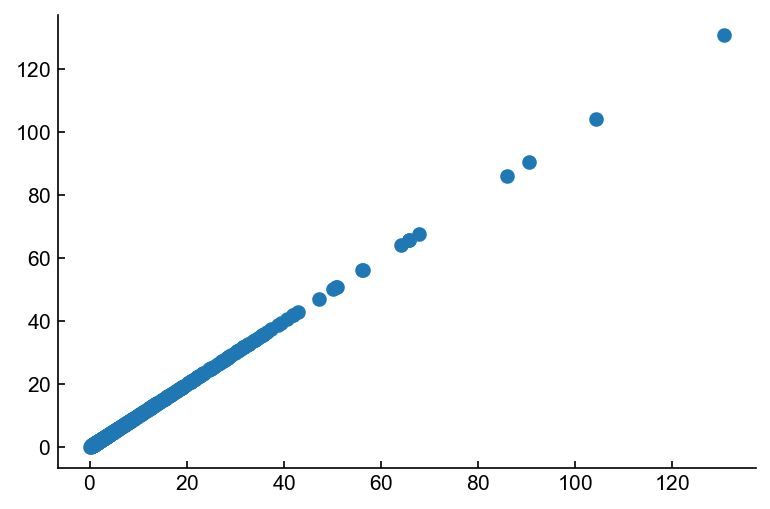

In [27]:
plt.scatter(FRmod_new,FRmod_old)

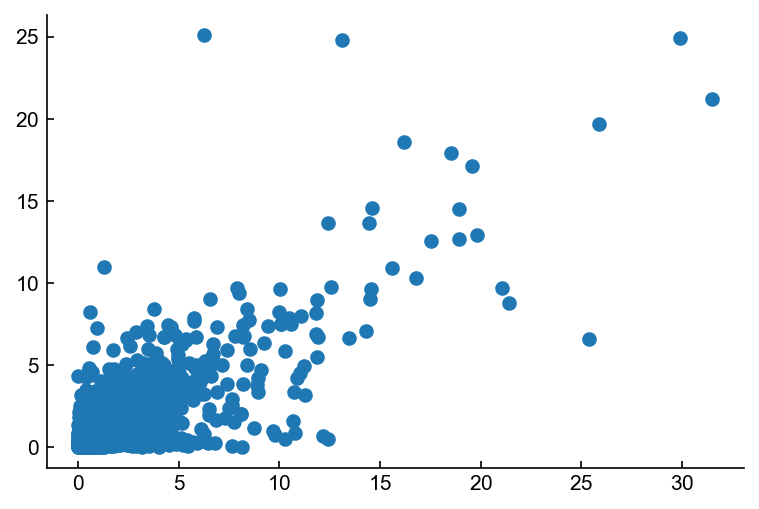

In [28]:
plt.scatter(ChoiceMod_new,ChoiceMod_old)